In [1]:
import os
import tarfile
import zipfile
import numpy as np
from pydub import AudioSegment
from scipy.io.wavfile import write
from scipy.signal import butter, lfilter, convolve
import librosa
import random
import torch
import torchaudio
import numpy as np
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split, Subset
from sklearn.metrics import roc_curve, accuracy_score, precision_score, recall_score, f1_score, auc # type: ignore
import matplotlib.pyplot as plt
from transformers import HubertModel, AutoProcessor
from tqdm import tqdm
import pickle
import torchvision.models as models

# FoR

In [27]:
real_audio_folder = "FoR/training/real"
fake_audio_folder = "FoR/training/fake"

real_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

for_train_files = real_files + fake_files

real_label = [1] * len(real_files)  
fake_label = [0] * len(fake_files)

train_labels = np.array(real_label + fake_label, dtype=np.int8)

print(f"Label array created with {len(train_labels)} labels, matching {len(for_train_files)} audio files.")


print(f"Found {len(real_files)} real audio files and {len(fake_files)} fake audio files.")
print(f"Total train audio files: {len(for_train_files)}")

Label array created with 53868 labels, matching 53868 audio files.
Found 26941 real audio files and 26927 fake audio files.
Total train audio files: 53868


In [31]:
real_audio_folder = "FoR/testing/real"
fake_audio_folder = "FoR/testing/fake"

real_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

for_testing_files = real_files + fake_files

real_label = [1] * len(real_files)  
fake_label = [0] * len(fake_files)

test_labels = np.array(real_label + fake_label, dtype=np.int8)

print(f"Label array created with {len(test_labels)} labels, matching {len(for_testing_files)} audio files.")

print(f"Found {len(real_files)} real audio files and {len(fake_files)} fake audio files.")
print(f"Total test audio files: {len(for_testing_files)}")

Label array created with 4634 labels, matching 4634 audio files.
Found 2264 real audio files and 2370 fake audio files.
Total test audio files: 4634


In [34]:
real_audio_folder = "FoR/validation/real"
fake_audio_folder = "FoR/validation/fake"

real_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

for_validation_files = real_files + fake_files

real_label = [1] * len(real_files)  
fake_label = [0] * len(fake_files)

validation_labels = np.array(real_label + fake_label, dtype=np.int8)

print(f"Label array created with {len(validation_labels)} labels, matching {len(for_validation_files)} audio files.")

print(f"Found {len(real_files)} real audio files and {len(fake_files)} fake audio files.")
print(f"Total validate audio files: {len(for_validation_files)}")

Label array created with 10798 labels, matching 10798 audio files.
Found 5400 real audio files and 5398 fake audio files.
Total validate audio files: 10798


# ASV

In [19]:
audio_folder = "ASV/Data"
protocol_file = "ASV/Labels.txt" 

asv_files = [f for f in os.listdir(audio_folder) if f.endswith(".flac")]
print(f"Found {len(asv_files)} audio files.")

random_files = random.sample(asv_files, min(5, len(asv_files)))
print("Randomly sampled filenames:")
for filename in random_files:
    print(filename)

Found 71933 audio files.
Randomly sampled filenames:
LA_E_9636420.flac
LA_E_7671858.flac
LA_E_9219763.flac
LA_E_4246068.flac
LA_E_8469633.flac


In [ ]:
label_dict = {}
with open(protocol_file, "r") as f:
    for line in f:
        parts = line.strip().split()
        if len(parts) < 5:
            continue
        _, filename, _, _, label = parts
        label_dict[filename] = 1 if label == "bonafide" else 0
print(f"Label dictionary created with {len(label_dict)} labels.")

Label dictionary created with 71237 labels.


# Artifacts

In [37]:
def compression(input_file, output_file, bitrate="64k"):
    audio = AudioSegment.from_file(input_file, format="flac")
    temp_mp3 = "temp.mp3"
    audio.export(temp_mp3, format="mp3", bitrate=bitrate)
    compressed_audio = AudioSegment.from_mp3(temp_mp3)
    compressed_audio.export(output_file, format="wav")
    os.remove(temp_mp3)

def add_noise(input_file, output_file, noise_type="gaussian", noise_level=0.01):
    y, sr = librosa.load(input_file, sr=None)
    if noise_type == "gaussian":
        noise = np.random.randn(len(y)) * noise_level
    elif noise_type == "pink":
        noise = np.cumsum(np.random.randn(len(y))) * noise_level
    elif noise_type == "white":
        noise = np.random.uniform(-1, 1, len(y)) * noise_level
    else:
        raise ValueError("Unsupported noise type.")
    y_noisy = y + noise
    write(output_file, sr, (y_noisy * 32767).astype(np.int16))

def apply_filter(input_file, output_file, filter_type="lowpass", cutoff_freq=1000):
    y, sr = librosa.load(input_file, sr=None)
    
    nyquist = 0.5 * sr
    normal_cutoff = cutoff_freq / nyquist
    if filter_type == "lowpass":
        b, a = butter(5, normal_cutoff, btype='low', analog=False)
    elif filter_type == "highpass":
        b, a = butter(5, normal_cutoff, btype='high', analog=False)
    elif filter_type == "bandpass":
        b, a = butter(5, [normal_cutoff - 0.1, normal_cutoff + 0.1], btype='band', analog=False)
    else:
        raise ValueError("Unsupported filter type.")
    y_filtered = lfilter(b, a, y)
    write(output_file, sr, (y_filtered * 32767).astype(np.int16))

def add_reverberation(input_file, output_file, rt60=0.5, sr=16000):
    y, _ = librosa.load(input_file, sr=sr)
    
    t = np.linspace(0, rt60, int(rt60 * sr))
    impulse_response = np.exp(-t * 4)
    y_reverb = convolve(y, impulse_response, mode="same")
    write(output_file, sr, (y_reverb * 32767).astype(np.int16))

def clipping(input_file, output_file, threshold=0.9):
    y, sr = librosa.load(input_file, sr=None)
    y_clipped = np.clip(y, -threshold, threshold)
    write(output_file, sr, (y_clipped * 32767).astype(np.int16))

In [38]:
artifact_functions = [
    ("compression", compression),
    ("noise", add_noise),
    ("filter", apply_filter),
    ("reverb", add_reverberation),
    ("clipping", clipping),
]

noise_types = ["gaussian", "pink", "white"]
filter_types = ["lowpass", "highpass", "bandpass"]

artifact_index = 0
noise_index = 0
filter_index = 0

def augment_all_files(file_list, input_folder, output_folder):
    global artifact_index, noise_index, filter_index
    for file_path in file_list:
        base_name = os.path.splitext(os.path.basename(file_path))[0]
        input_file = os.path.join(input_folder, os.path.basename(file_path))

        artifact_name, artifact_function = artifact_functions[artifact_index]
        output_file = os.path.join(output_folder, f"{base_name}_{artifact_name}.wav")

        try:
            if artifact_name == "noise":
                noise_type = noise_types[noise_index]
                artifact_function(input_file, output_file, noise_type=noise_type, noise_level=0.01)
                noise_index = (noise_index + 1) % len(noise_types)
            elif artifact_name == "filter":
                filter_type = filter_types[filter_index]
                artifact_function(input_file, output_file, filter_type=filter_type, cutoff_freq=1000)
                filter_index = (filter_index + 1) % len(filter_types)
            else:
                artifact_function(input_file, output_file)

            print(f"Applied {artifact_name} to {input_file} -> Saved as {output_file}")

        except Exception as e:
            print(f"Failed to apply {artifact_name} to {input_file}: {e}")

        artifact_index = (artifact_index + 1) % len(artifact_functions)

In [39]:
artifacts_folder = "ASV/Artifact"
os.makedirs(artifacts_folder, exist_ok=True)

augment_all_files(asv_files, audio_folder, artifacts_folder)

Applied compression to ASV/Data/LA_E_1661046.flac -> Saved as ASV/Artifact/LA_E_1661046_compression.wav
Applied noise to ASV/Data/LA_E_1082676.flac -> Saved as ASV/Artifact/LA_E_1082676_noise.wav
Applied filter to ASV/Data/LA_E_7144235.flac -> Saved as ASV/Artifact/LA_E_7144235_filter.wav
Applied reverb to ASV/Data/LA_E_8575849.flac -> Saved as ASV/Artifact/LA_E_8575849_reverb.wav
Applied clipping to ASV/Data/LA_E_3095112.flac -> Saved as ASV/Artifact/LA_E_3095112_clipping.wav
Applied compression to ASV/Data/LA_E_9732126.flac -> Saved as ASV/Artifact/LA_E_9732126_compression.wav
Applied noise to ASV/Data/LA_E_9972018.flac -> Saved as ASV/Artifact/LA_E_9972018_noise.wav
Applied filter to ASV/Data/LA_E_1685568.flac -> Saved as ASV/Artifact/LA_E_1685568_filter.wav
Applied reverb to ASV/Data/LA_E_8655892.flac -> Saved as ASV/Artifact/LA_E_8655892_reverb.wav
Applied clipping to ASV/Data/LA_E_9844853.flac -> Saved as ASV/Artifact/LA_E_9844853_clipping.wav
Applied compression to ASV/Data/LA_E

In [58]:
audio_folder = "ASV/Data"
artifacts_folder = "ASV/Artifact"

original_files = [os.path.join(audio_folder, f) for f in os.listdir(audio_folder) if f.endswith(".flac")]
artifacts_files = [os.path.join(artifacts_folder, f) for f in os.listdir(artifacts_folder) if f.endswith(".wav")]

ASV_files = original_files + artifacts_files

ASV_labels = []
for file in ASV_files:
    filename = os.path.basename(file)
    name_without_ext = os.path.splitext(filename)[0]
    
    if filename.endswith(".flac"):
        base_name = name_without_ext
    else:
        base_name = "_".join(name_without_ext.split("_")[:-1])
    
    label = label_dict.get(base_name, None)
    
    if label is not None:
        ASV_labels.append(label)

    else:
        ASV_labels.append(random.randint(0, 1))
        print(f"Warning: No label found for file {base_name} Skipping.")

print(f"Total files: {len(ASV_files)}, Total labels: {len(ASV_labels)}")

Total files: 143866, Total labels: 143866


In [29]:
real_artifacts_folder = "FoR/training/real_artifacts"
fake_artifacts_folder = "FoR/training/fake_artifacts"

os.makedirs(real_artifacts_folder, exist_ok=True)
os.makedirs(fake_artifacts_folder, exist_ok=True)

augment_all_files(real_files, real_artifacts_folder)
augment_all_files(fake_files, fake_artifacts_folder)


Applied compression to FoR/training/real/file24187.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/training/real_artifacts/file24187.wav_16k.wav_norm.wav_mono.wav_silence_compression.wav
Applied noise to FoR/training/real/file18122.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/training/real_artifacts/file18122.wav_16k.wav_norm.wav_mono.wav_silence_noise.wav
Applied filter to FoR/training/real/file29690.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/training/real_artifacts/file29690.wav_16k.wav_norm.wav_mono.wav_silence_filter.wav
Applied reverb to FoR/training/real/file1020.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/training/real_artifacts/file1020.wav_16k.wav_norm.wav_mono.wav_silence_reverb.wav
Applied clipping to FoR/training/real/file31559.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/training/real_artifacts/file31559.wav_16k.wav_norm.wav_mono.wav_silence_clipping.wav
Applied compression to FoR/training/real/file21627.wav_

In [83]:
real_audio_folder = "FoR/training/real"
fake_audio_folder = "FoR/training/fake"

real_artifacts_folder = "FoR/training/real_artifacts"
fake_artifacts_folder = "FoR/training/fake_artifacts"

os.makedirs(real_artifacts_folder, exist_ok=True)
os.makedirs(fake_artifacts_folder, exist_ok=True)

real_original_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_original_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

real_artifacts_files = [os.path.join(real_artifacts_folder, f) for f in os.listdir(real_artifacts_folder) if f.endswith(".wav")]
fake_artifacts_files = [os.path.join(fake_artifacts_folder, f) for f in os.listdir(fake_artifacts_folder) if f.endswith(".wav")]

real_files = real_original_files + real_artifacts_files
fake_files = fake_original_files + fake_artifacts_files

for_training_files = real_files + fake_files

real_label = [1] * len(real_files)
fake_label = [0] * len(fake_files)

training_labels = np.array(real_label + fake_label, dtype=np.int8)

print(f"Label array created with {len(training_labels)} labels, matching {len(for_training_files)} audio files.")

print(f"Found {len(real_files)} real audio files and {len(fake_files)} fake audio files.")
print(f"Total training audio files: {len(for_training_files)}")

Label array created with 107736 labels, matching 107736 audio files.
Found 53882 real audio files and 53854 fake audio files.
Total training audio files: 107736


In [32]:
real_artifacts_folder = "FoR/testing/real_artifacts"
fake_artifacts_folder = "FoR/testing/fake_artifacts"

os.makedirs(real_artifacts_folder, exist_ok=True)
os.makedirs(fake_artifacts_folder, exist_ok=True)

augment_all_files(real_files, real_artifacts_folder)
augment_all_files(fake_files, fake_artifacts_folder)


Applied reverb to FoR/testing/real/file1020.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/testing/real_artifacts/file1020.wav_16k.wav_norm.wav_mono.wav_silence_reverb.wav
Applied clipping to FoR/testing/real/file1595.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/testing/real_artifacts/file1595.wav_16k.wav_norm.wav_mono.wav_silence_clipping.wav
Applied compression to FoR/testing/real/file556.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/testing/real_artifacts/file556.wav_16k.wav_norm.wav_mono.wav_silence_compression.wav
Applied noise to FoR/testing/real/file1590.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/testing/real_artifacts/file1590.wav_16k.wav_norm.wav_mono.wav_silence_noise.wav
Applied filter to FoR/testing/real/file617.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/testing/real_artifacts/file617.wav_16k.wav_norm.wav_mono.wav_silence_filter.wav
Applied reverb to FoR/testing/real/file441.wav_16k.wav_norm.wav_mono.wav_sile

In [33]:
real_audio_folder = "FoR/testing/real"
fake_audio_folder = "FoR/testing/fake"

real_artifacts_folder = "FoR/testing/real_artifacts"
fake_artifacts_folder = "FoR/testing/fake_artifacts"

os.makedirs(real_artifacts_folder, exist_ok=True)
os.makedirs(fake_artifacts_folder, exist_ok=True)

real_original_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_original_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

real_artifacts_files = [os.path.join(real_artifacts_folder, f) for f in os.listdir(real_artifacts_folder) if f.endswith(".wav")]
fake_artifacts_files = [os.path.join(fake_artifacts_folder, f) for f in os.listdir(fake_artifacts_folder) if f.endswith(".wav")]

real_files = real_original_files + real_artifacts_files
fake_files = fake_original_files + fake_artifacts_files

for_testing_files = real_files + fake_files

real_label = [1] * len(real_files)
fake_label = [0] * len(fake_files)

testing_labels = np.array(real_label + fake_label, dtype=np.int8)

print(f"Label array created with {len(testing_labels)} labels, matching {len(for_testing_files)} audio files.")

print(f"Found {len(real_files)} real audio files and {len(fake_files)} fake audio files.")
print(f"Total training audio files: {len(for_testing_files)}")

Label array created with 9268 labels, matching 9268 audio files.
Found 4528 real audio files and 4740 fake audio files.
Total training audio files: 9268


In [35]:
real_artifacts_folder = "FoR/validation/real_artifacts"
fake_artifacts_folder = "FoR/validation/fake_artifacts"

os.makedirs(real_artifacts_folder, exist_ok=True)
os.makedirs(fake_artifacts_folder, exist_ok=True)

augment_all_files(real_files, real_artifacts_folder)
augment_all_files(fake_files, fake_artifacts_folder)

Applied filter to FoR/validation/real/file21876.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/validation/real_artifacts/file21876.wav_16k.wav_norm.wav_mono.wav_silence_filter.wav
Applied reverb to FoR/validation/real/file10273.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/validation/real_artifacts/file10273.wav_16k.wav_norm.wav_mono.wav_silence_reverb.wav
Applied clipping to FoR/validation/real/file2452.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/validation/real_artifacts/file2452.wav_16k.wav_norm.wav_mono.wav_silence_clipping.wav
Applied compression to FoR/validation/real/file16736.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/validation/real_artifacts/file16736.wav_16k.wav_norm.wav_mono.wav_silence_compression.wav
Applied noise to FoR/validation/real/file3766.wav_16k.wav_norm.wav_mono.wav_silence.wav -> Saved as FoR/validation/real_artifacts/file3766.wav_16k.wav_norm.wav_mono.wav_silence_noise.wav
Applied filter to FoR/validation/real

In [81]:
real_audio_folder = "FoR/validation/real"
fake_audio_folder = "FoR/validation/fake"

real_artifacts_folder = "FoR/validation/real_artifacts"
fake_artifacts_folder = "FoR/validation/fake_artifacts"

os.makedirs(real_artifacts_folder, exist_ok=True)
os.makedirs(fake_artifacts_folder, exist_ok=True)

real_original_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_original_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

real_artifacts_files = [os.path.join(real_artifacts_folder, f) for f in os.listdir(real_artifacts_folder) if f.endswith(".wav")]
fake_artifacts_files = [os.path.join(fake_artifacts_folder, f) for f in os.listdir(fake_artifacts_folder) if f.endswith(".wav")]

real_files = real_original_files + real_artifacts_files
fake_files = fake_original_files + fake_artifacts_files

for_validation_files = real_files + fake_files

real_label = [1] * len(real_files)
fake_label = [0] * len(fake_files)

validation_labels = np.array(real_label + fake_label, dtype=np.int8)

print(f"Label array created with {len(validation_labels)} labels, matching {len(for_validation_files)} audio files.")

print(f"Found {len(real_files)} real audio files and {len(fake_files)} fake audio files.")
print(f"Total training audio files: {len(for_validation_files)}")

Label array created with 21596 labels, matching 21596 audio files.
Found 10800 real audio files and 10796 fake audio files.
Total training audio files: 21596


# Hubert

In [59]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
processor = AutoProcessor.from_pretrained("facebook/hubert-large-ls960-ft")
model = HubertModel.from_pretrained("facebook/hubert-large-ls960-ft").to(device)
model.eval()
print(device)

cuda


In [ ]:
BATCH_SIZE = 64

def process_batch(filenames):
    waveforms = []
    features = []
    successful_files = []
    
    for filename in filenames:
        try:
            waveform, sample_rate = torchaudio.load(filename)
            waveform = waveform.to(device)

            if sample_rate != 16000:
                resampler = torchaudio.transforms.Resample(orig_freq=sample_rate, new_freq=16000)
                waveform = resampler(waveform)

            if waveform.shape[0] > 1:  
                waveform = torch.mean(waveform, dim=0, keepdim=True)

            waveforms.append(waveform.squeeze(0))
            successful_files.append(filename)
        except RuntimeError as e:
            print(f"Error loading {filename}: {e}")
            continue  

    with torch.no_grad():
        for waveform in waveforms:
            inputs = processor(waveform, sampling_rate=16000, return_tensors="pt").to(device)
            outputs = model(**inputs)
            features.append(outputs.last_hidden_state.mean(dim=1).cpu().numpy().flatten())

    return features, successful_files

In [62]:
def get_pkl(files, labels, output_file):
    features, filtered_labels = [], []
    
    for i in tqdm(range(0, len(files), BATCH_SIZE), desc="Extracting features"):
        batch_files = files[i:i + BATCH_SIZE]
        batch_labels = labels[i:i + BATCH_SIZE]
        
        batch_features, successful_files = process_batch(batch_files)
        
        successful_indices = [batch_files.index(file) for file in successful_files]
        filtered_batch_labels = [batch_labels[idx] for idx in successful_indices]
        
        features.extend(batch_features)
        filtered_labels.extend(filtered_batch_labels)

    features = np.array(features, dtype=np.float32)
    filtered_labels = np.array(filtered_labels, dtype=np.int8)

    with open(output_file, "wb") as f:
        pickle.dump({"features": features, "labels": filtered_labels}, f)

    print(f"Saved extracted features to {output_file}")
    print(f"Features: {len(features)}, Labels: {len(filtered_labels)}")

In [84]:
get_pkl(for_training_files, training_labels, "FoR_Train_Aug_Dataset.pkl")

Extracting features:   5%|▌         | 85/1684 [02:20<43:01,  1.61s/it]

Error loading FoR/training/real/file11064.wav_16k.wav_norm.wav_mono.wav_silence.wav: Failed to decode audio.


Extracting features:  18%|█▊        | 306/1684 [08:25<39:26,  1.72s/it]

Error loading FoR/training/real/file15440.wav_16k.wav_norm.wav_mono.wav_silence.wav: Failed to decode audio.


Extracting features:  46%|████▌     | 778/1684 [21:22<24:18,  1.61s/it]

Error loading FoR/training/real_artifacts/file11064.wav_16k.wav_norm.wav_mono.wav_silence_clipping.wav: Failed to decode audio.


Extracting features:  48%|████▊     | 815/1684 [22:23<23:13,  1.60s/it]

Error loading FoR/training/real_artifacts/file15440.wav_16k.wav_norm.wav_mono.wav_silence_filter.wav: Failed to decode audio.


Extracting features: 100%|██████████| 1684/1684 [35:34<00:00,  1.27s/it]


Saved extracted features to FoR_Train_Aug_Dataset.pkl
Features: 107732, Labels: 107732


In [82]:
get_pkl(for_validation_files, validation_labels, "FoR_Validation_Aug_Dataset.pkl")

Extracting features: 100%|██████████| 338/338 [07:09<00:00,  1.27s/it]

Saved extracted features to FoR_Validation_Aug_Dataset.pkl
Features: 21596, Labels: 21596


In [80]:
get_pkl(for_testing_files, testing_labels, "FoR_Test_Aug_Dataset.pkl")

Extracting features: 100%|██████████| 145/145 [02:22<00:00,  1.02it/s]

Saved extracted features to FoR_Test_Aug_Dataset.pkl
Features: 9268, Labels: 9268


In [ ]:
get_pkl(ASV_files, ASV_labels, "ASV_Aug_Dataset.pkl")

Extracting features: 100%|██████████| 2248/2248 [44:49<00:00,  1.20s/it]


Saved extracted features to ASV_Dataset.pkl
Features: 143866, Labels: 143866


# Model

In [34]:
class DeepfakeDataset(Dataset):
    def __init__(self, data_dict):
        self.features = torch.tensor(data_dict["features"], dtype=torch.float32)
        self.labels = torch.tensor(data_dict["labels"], dtype=torch.long)

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return self.features[idx], self.labels[idx]

In [47]:
class MaxFeatureMap1D(nn.Module):
    def forward(self, x):
        out = x.view(x.size(0), x.size(1) // 2, 2, x.size(2))
        out = out.max(dim=2)[0]
        return out

class DeepfakeClassifier(nn.Module):
    def __init__(self, input_dim=1024, hidden_dim=512, lstm_hidden_dim=256, num_classes=2):
        super(DeepfakeClassifier, self).__init__()

        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.relu = nn.ReLU()

        self.conv1 = nn.Conv1d(1, 64, kernel_size=5, stride=1, padding=2)
        self.mfm1 = MaxFeatureMap1D()  
        self.pool1 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.conv2 = nn.Conv1d(32, 64, kernel_size=1, stride=1)
        self.mfm2 = MaxFeatureMap1D()
        self.batchnorm1 = nn.BatchNorm1d(32)
        self.conv3 = nn.Conv1d(32, 96, kernel_size=3, stride=1, padding=1)
        self.mfm3 = MaxFeatureMap1D()
        self.pool2 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.batchnorm2 = nn.BatchNorm1d(48)
        self.conv4 = nn.Conv1d(48, 96, kernel_size=1, stride=1)
        self.mfm4 = MaxFeatureMap1D()
        self.batchnorm3 = nn.BatchNorm1d(48)
        self.conv5 = nn.Conv1d(48, 128, kernel_size=3, stride=1, padding=1)
        self.mfm5 = MaxFeatureMap1D()
        self.pool3 = nn.MaxPool1d(kernel_size=2, stride=2)

        
        self.lstm1 = nn.LSTM(input_size=64, hidden_size=lstm_hidden_dim, num_layers=1, 
                             bidirectional=True, batch_first=True)
        self.lstm2 = nn.LSTM(input_size=lstm_hidden_dim * 2, hidden_size=lstm_hidden_dim, num_layers=1, 
                             bidirectional=True, batch_first=True)

        self.gap = nn.AdaptiveAvgPool1d(1)

        self.fc2 = nn.Linear(lstm_hidden_dim * 2, num_classes)

    def forward(self, x):
        x = self.fc1(x)
        x = self.relu(x)

        x = x.unsqueeze(1)
        x = self.conv1(x)
        x = self.mfm1(x)
        x = self.pool1(x)
        x = self.conv2(x)
        x = self.mfm2(x)
        x = self.batchnorm1(x)
        x = self.conv3(x)
        x = self.mfm3(x)
        x = self.pool2(x)
        x = self.batchnorm2(x)
        x = self.conv4(x)
        x = self.mfm4(x)
        x = self.batchnorm3(x)
        x = self.conv5(x)
        x = self.mfm5(x)
        x = self.pool3(x)

        x = x.permute(0, 2, 1)
        x, _ = self.lstm1(x)
        x, _ = self.lstm2(x)

        x = x.permute(0, 2, 1)
        x = self.gap(x).squeeze(-1)
        
        x = self.fc2(x)
        return x

In [48]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = DeepfakeClassifier().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
print(device)

cuda


In [49]:
num_epochs = 50

def Train(train_loader, val_loader, eer_per_epoch):
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0

        for features, labels in train_loader:
            features, labels = features.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(features)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

        avg_loss = running_loss / len(train_loader)

        model.eval()
        all_labels = []
        all_probs = []

        with torch.no_grad():
            for features, labels in val_loader:
                features, labels = features.to(device), labels.to(device)
                outputs = model(features)
                
                probs = torch.softmax(outputs, dim=1)[:, 1]

                all_labels.extend(labels.cpu().numpy())
                all_probs.extend(probs.detach().cpu().numpy())

        all_labels = np.array(all_labels)
        all_probs = np.array(all_probs)

        fpr, tpr, thresholds = roc_curve(all_labels, all_probs)
        fnr = 1 - tpr
        
        eer_index = np.nanargmin(np.abs(fpr - fnr))
        eer = fpr[eer_index]

        eer_per_epoch.append(eer)

        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}, Validate EER: {eer:.4f}")

In [50]:
def Test(test_loader, name):
    all_labels = []
    all_preds = []
    all_probs = []

    model.eval()
    with torch.no_grad():
        for features, labels in test_loader:
            features, labels = features.to(device), labels.to(device)
            outputs = model(features)

            probs = torch.softmax(outputs, dim=1)[:, 1]
            preds = torch.argmax(outputs, dim=1)

            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
            all_probs.extend(probs.detach().cpu().numpy())

    all_labels = np.array(all_labels)
    all_preds = np.array(all_preds)
    all_probs = np.array(all_probs)

    accuracy = accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds)
    recall = recall_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds)

    TP = np.sum((all_preds == 1) & (all_labels == 1))
    TN = np.sum((all_preds == 0) & (all_labels == 0))
    FP = np.sum((all_preds == 1) & (all_labels == 0))
    FN = np.sum((all_preds == 0) & (all_labels == 1))

    fpr_manual = FP / (FP + TN) if (FP + TN) > 0 else 0.0
    fnr_manual = FN / (FN + TP) if (FN + TP) > 0 else 0.0

    fpr, tpr, thresholds = roc_curve(all_labels, all_probs)
    fnr = 1 - tpr

    eer_index = np.nanargmin(np.abs(fpr - fnr))
    eer = fpr[eer_index]
    
    print("Evaluation Metrics on Test Set:")
    print(f"Accuracy:  {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall:    {recall:.4f}")
    print(f"F1 Score:  {f1:.4f}")
    print(f"FPR:       {fpr_manual:.4f}")
    print(f"FNR:       {fnr_manual:.4f}")
    print(f"EER:       {eer:.4f}")
    
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', label=f'ROC Curve (AUC = {auc(fpr, tpr):.4f})')
    plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label="Random Classifier")
    plt.scatter(fpr[eer_index], tpr[eer_index], color='red', label=f"EER Point ({eer:.4f})")
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title(name + "ROC Curve")
    plt.legend()
    plt.grid(True)
    plt.show()

In [93]:
with open("ASV_Dataset.pkl", "rb") as f:
    data = pickle.load(f)

features = data["features"]
labels = data["labels"]

valid_indices = (labels == 0) | (labels == 1)

filtered_features = features[valid_indices]
filtered_labels = labels[valid_indices]

cleaned_data = {"features": filtered_features, "labels": filtered_labels}
print(filtered_features.shape)
print(filtered_labels.shape)

(71237, 1024)
(71237,)


In [95]:
with open("ASV_Aug_Dataset.pkl", "rb") as f:
    data = pickle.load(f)

features = data["features"]
labels = data["labels"]

valid_indices = (labels == 0) | (labels == 1)

filtered_features = features[valid_indices]
filtered_labels = labels[valid_indices]

cleaned_data = {"features": filtered_features, "labels": filtered_labels}
print(filtered_features.shape)
print(filtered_labels.shape)

(143866, 1024)
(143866,)


In [94]:
dataset = DeepfakeDataset(cleaned_data)

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

ASV_train_dataset, ASV_val_dataset, ASV_test_dataset = random_split(dataset, [train_size, val_size, test_size])
print(f"Training samples: {train_size}, Validation samples: {val_size}, Testing samples: {test_size}")

Training samples: 56989, Validation samples: 7123, Testing samples: 7125


In [96]:
Aug_dataset = DeepfakeDataset(cleaned_data)

train_size = int(0.8 * len(Aug_dataset))
val_size = int(0.1 * len(Aug_dataset))
test_size = len(Aug_dataset) - train_size - val_size

ASV_Art_train_dataset, ASV_Art_val_dataset, ASV_Art_test_dataset = random_split(Aug_dataset, [train_size, val_size, test_size])
print(f"Training samples: {train_size}, Validation samples: {val_size}, Testing samples: {test_size}")

Training samples: 115092, Validation samples: 14386, Testing samples: 14388


In [103]:
train_loader = DataLoader(ASV_Art_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(ASV_Art_val_dataset, batch_size=64, shuffle=False)

print(f"Training size: {len(ASV_Art_train_dataset)}, Validation size: {len(ASV_Art_val_dataset)}")


Training size: 115092, Validation size: 14386


In [100]:
test_loader = DataLoader(ASV_Art_test_dataset, batch_size=64, shuffle=False)

print(f"Test size: {len(ASV_Art_test_dataset)}")

Test size: 14388


Trained without artifacts

In [8]:
with open("FoR_Train_Dataset.pkl", "rb") as f:
    for_train_data = pickle.load(f)

with open("FoR_Validation_Dataset.pkl", "rb") as f:
    for_val_data = pickle.load(f)

with open("FoR_Test_Aug_Dataset.pkl", "rb") as f:
    for_test_data = pickle.load(f)
        

FoR_train_dataset = DeepfakeDataset(for_train_data)
FoR_val_dataset = DeepfakeDataset(for_val_data)
FoR_test_dataset = DeepfakeDataset(for_test_data)

train_loader = DataLoader(FoR_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(FoR_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(FoR_test_dataset, batch_size=64, shuffle=False)


print(f"Training samples: {len(FoR_train_dataset)}, Validation samples: {len(FoR_val_dataset)}, Testing samples: {len(FoR_test_dataset)}")

Training samples: 53866, Validation samples: 10798, Testing samples: 9268


In [10]:
FoR_eer_per_epoch = []
Train(train_loader, val_loader, FoR_eer_per_epoch)

Epoch 1/50, Loss: 0.0665, Test EER: 0.0213
Epoch 2/50, Loss: 0.0593, Test EER: 0.0213
Epoch 3/50, Loss: 0.0587, Test EER: 0.0189
Epoch 4/50, Loss: 0.0586, Test EER: 0.0189
Epoch 5/50, Loss: 0.0566, Test EER: 0.0232
Epoch 6/50, Loss: 0.0533, Test EER: 0.0187
Epoch 7/50, Loss: 0.0538, Test EER: 0.0195
Epoch 8/50, Loss: 0.0529, Test EER: 0.0193
Epoch 9/50, Loss: 0.0512, Test EER: 0.0176
Epoch 10/50, Loss: 0.0508, Test EER: 0.0187
Epoch 11/50, Loss: 0.0507, Test EER: 0.0183
Epoch 12/50, Loss: 0.0497, Test EER: 0.0204
Epoch 13/50, Loss: 0.0506, Test EER: 0.0185
Epoch 14/50, Loss: 0.0485, Test EER: 0.0202
Epoch 15/50, Loss: 0.0487, Test EER: 0.0191
Epoch 16/50, Loss: 0.0484, Test EER: 0.0211
Epoch 17/50, Loss: 0.0464, Test EER: 0.0191
Epoch 18/50, Loss: 0.0505, Test EER: 0.0189
Epoch 19/50, Loss: 0.0477, Test EER: 0.0180
Epoch 20/50, Loss: 0.0459, Test EER: 0.0200
Epoch 21/50, Loss: 0.0466, Test EER: 0.0182
Epoch 22/50, Loss: 0.0467, Test EER: 0.0185
Epoch 23/50, Loss: 0.0472, Test EER: 0.01

Evaluation Metrics on Test Set:
Accuracy:  0.8879
Precision: 0.8362
Recall:    0.9583
F1 Score:  0.8931
FPR:       0.1793
FNR:       0.0417
EER:       0.1124


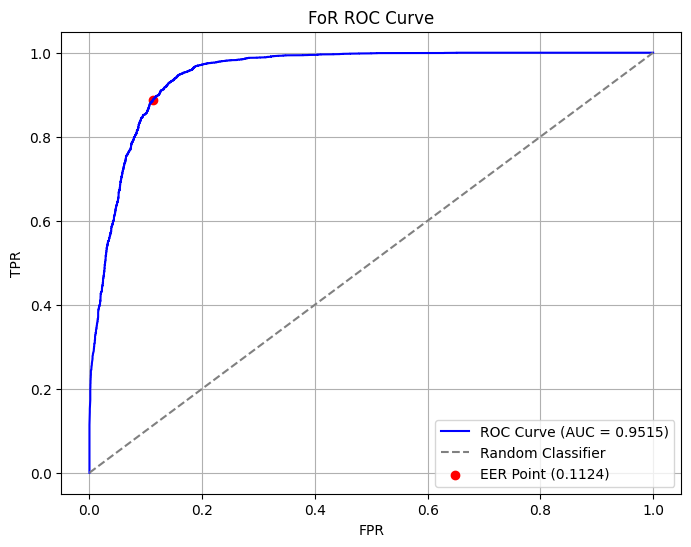

In [11]:
Test(test_loader, "FoR ")

In [101]:
ASV_eer_per_epoch = []
Train(train_loader, val_loader, ASV_eer_per_epoch)

Epoch 1/50, Loss: 0.0675, Test EER: 0.0326
Epoch 2/50, Loss: 0.0622, Test EER: 0.0299
Epoch 3/50, Loss: 0.0586, Test EER: 0.0293
Epoch 4/50, Loss: 0.0573, Test EER: 0.0264
Epoch 5/50, Loss: 0.0544, Test EER: 0.0242
Epoch 6/50, Loss: 0.0529, Test EER: 0.0253
Epoch 7/50, Loss: 0.0536, Test EER: 0.0242
Epoch 8/50, Loss: 0.0502, Test EER: 0.0241
Epoch 9/50, Loss: 0.0482, Test EER: 0.0234
Epoch 10/50, Loss: 0.0470, Test EER: 0.0238
Epoch 11/50, Loss: 0.0467, Test EER: 0.0242
Epoch 12/50, Loss: 0.0435, Test EER: 0.0222
Epoch 13/50, Loss: 0.0456, Test EER: 0.0230
Epoch 14/50, Loss: 0.0434, Test EER: 0.0227
Epoch 15/50, Loss: 0.0439, Test EER: 0.0206
Epoch 16/50, Loss: 0.0448, Test EER: 0.0233
Epoch 17/50, Loss: 0.0429, Test EER: 0.0225
Epoch 18/50, Loss: 0.0421, Test EER: 0.0225
Epoch 19/50, Loss: 0.0426, Test EER: 0.0220
Epoch 20/50, Loss: 0.0443, Test EER: 0.0212
Epoch 21/50, Loss: 0.0417, Test EER: 0.0252
Epoch 22/50, Loss: 0.0400, Test EER: 0.0212
Epoch 23/50, Loss: 0.0468, Test EER: 0.02

Evaluation Metrics on Test Set:
Accuracy:  0.9602
Precision: 0.9364
Recall:    0.6761
F1 Score:  0.7853
FPR:       0.0055
FNR:       0.3239
EER:       0.0999


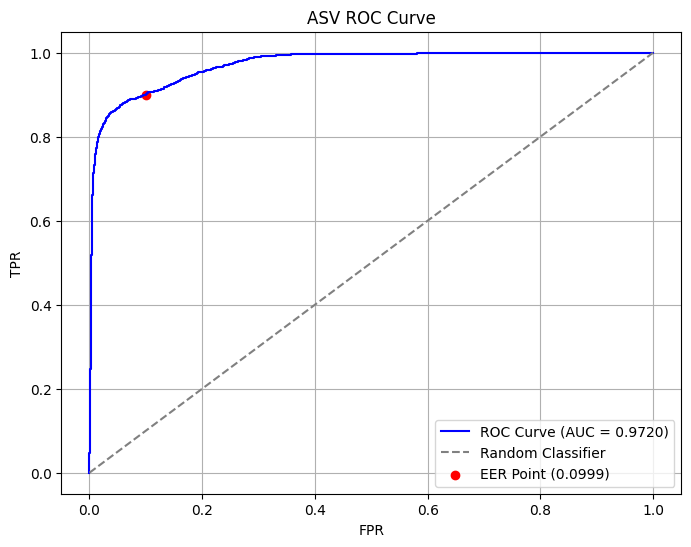

In [102]:
Test(test_loader, "ASV ")

Trained with Artifacts

In [12]:
with open("FoR_Train_Aug_Dataset.pkl", "rb") as f:
    for_train_data = pickle.load(f)

with open("FoR_Validation_Aug_Dataset.pkl", "rb") as f:
    for_val_data = pickle.load(f)

with open("FoR_Test_Aug_Dataset.pkl", "rb") as f:
    for_test_data = pickle.load(f)
        

FoR_train_dataset = DeepfakeDataset(for_train_data)
FoR_val_dataset = DeepfakeDataset(for_val_data)
FoR_test_dataset = DeepfakeDataset(for_test_data)

train_loader = DataLoader(FoR_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(FoR_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(FoR_test_dataset, batch_size=64, shuffle=False)


print(f"Training samples: {len(FoR_train_dataset)}, Validation samples: {len(FoR_val_dataset)}, Testing samples: {len(FoR_test_dataset)}")

Training samples: 107732, Validation samples: 21596, Testing samples: 9268


In [13]:
FoR_Art_eer_per_epoch = []
Train(train_loader, val_loader, FoR_Art_eer_per_epoch)

Epoch 1/50, Loss: 0.0976, Test EER: 0.0344
Epoch 2/50, Loss: 0.0845, Test EER: 0.0338
Epoch 3/50, Loss: 0.0804, Test EER: 0.0331
Epoch 4/50, Loss: 0.0789, Test EER: 0.0295
Epoch 5/50, Loss: 0.0752, Test EER: 0.0307
Epoch 6/50, Loss: 0.0736, Test EER: 0.0396
Epoch 7/50, Loss: 0.0730, Test EER: 0.0302
Epoch 8/50, Loss: 0.0709, Test EER: 0.0331
Epoch 9/50, Loss: 0.0704, Test EER: 0.0345
Epoch 10/50, Loss: 0.0716, Test EER: 0.0299
Epoch 11/50, Loss: 0.0683, Test EER: 0.0330
Epoch 12/50, Loss: 0.0684, Test EER: 0.0311
Epoch 13/50, Loss: 0.0664, Test EER: 0.0288
Epoch 14/50, Loss: 0.0667, Test EER: 0.0358
Epoch 15/50, Loss: 0.0652, Test EER: 0.0286
Epoch 16/50, Loss: 0.0661, Test EER: 0.0274
Epoch 17/50, Loss: 0.0631, Test EER: 0.0474
Epoch 18/50, Loss: 0.0634, Test EER: 0.0295
Epoch 19/50, Loss: 0.0631, Test EER: 0.0279
Epoch 20/50, Loss: 0.0614, Test EER: 0.0304
Epoch 21/50, Loss: 0.0620, Test EER: 0.0303
Epoch 22/50, Loss: 0.0609, Test EER: 0.0288
Epoch 23/50, Loss: 0.0605, Test EER: 0.03

Evaluation Metrics on Test Set:
Accuracy:  0.9246
Precision: 0.9470
Recall:    0.8958
F1 Score:  0.9207
FPR:       0.0479
FNR:       0.1042
EER:       0.0698


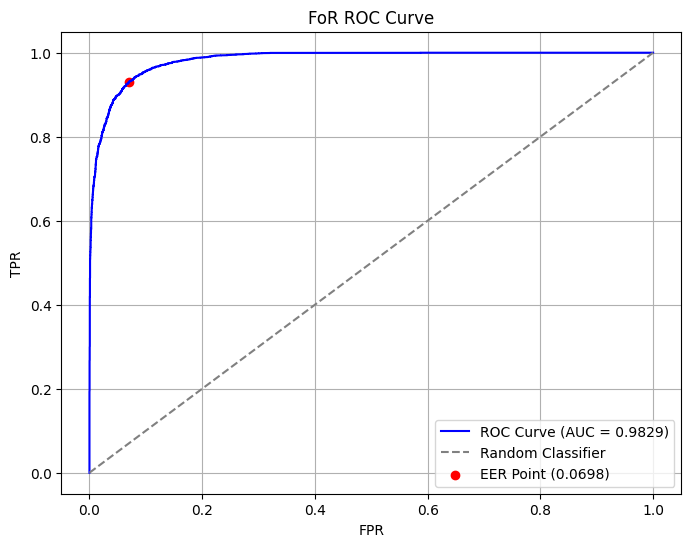

In [14]:
Test(test_loader, "FoR ")

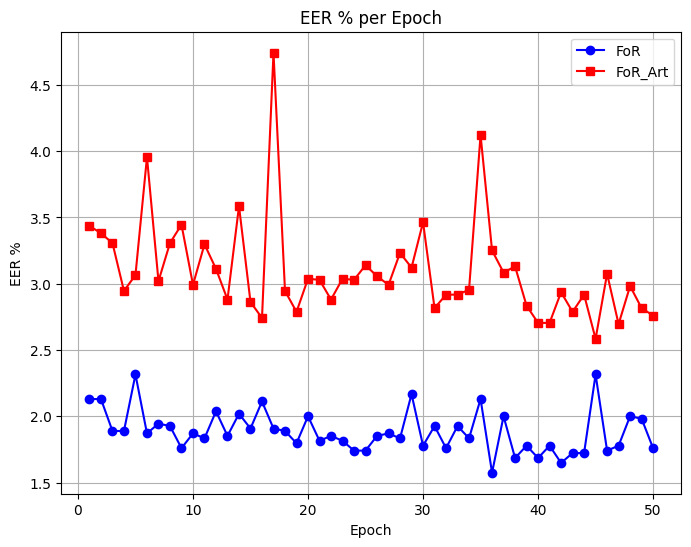

In [15]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs+1), [100*eer for eer in FoR_eer_per_epoch], marker='o', label="FoR", color='b')
plt.plot(range(1, num_epochs+1), [100*eer for eer in FoR_Art_eer_per_epoch], marker='s', label="FoR_Art", color='r')

plt.xlabel("Epoch")
plt.ylabel("EER %")
plt.title("EER % per Epoch")
plt.legend()
plt.grid(True)
plt.show()

In [104]:
ASV_Art_eer_per_epoch = []
Train(train_loader, val_loader, ASV_Art_eer_per_epoch)

Epoch 1/50, Loss: 0.1038, Test EER: 0.0776
Epoch 2/50, Loss: 0.0989, Test EER: 0.0648
Epoch 3/50, Loss: 0.0917, Test EER: 0.0542
Epoch 4/50, Loss: 0.0919, Test EER: 0.0532
Epoch 5/50, Loss: 0.0882, Test EER: 0.0608
Epoch 6/50, Loss: 0.0884, Test EER: 0.0479
Epoch 7/50, Loss: 0.0866, Test EER: 0.0520
Epoch 8/50, Loss: 0.0862, Test EER: 0.0490
Epoch 9/50, Loss: 0.0856, Test EER: 0.0496
Epoch 10/50, Loss: 0.0850, Test EER: 0.0467
Epoch 11/50, Loss: 0.0835, Test EER: 0.0469
Epoch 12/50, Loss: 0.0830, Test EER: 0.0495
Epoch 13/50, Loss: 0.0820, Test EER: 0.1646
Epoch 14/50, Loss: 0.0820, Test EER: 0.0478
Epoch 15/50, Loss: 0.0820, Test EER: 0.0484
Epoch 16/50, Loss: 0.0820, Test EER: 0.0489
Epoch 17/50, Loss: 0.0814, Test EER: 0.0471
Epoch 18/50, Loss: 0.0827, Test EER: 0.0652
Epoch 19/50, Loss: 0.0839, Test EER: 0.0467
Epoch 20/50, Loss: 0.0817, Test EER: 0.0491
Epoch 21/50, Loss: 0.0811, Test EER: 0.0549
Epoch 22/50, Loss: 0.0816, Test EER: 0.0479
Epoch 23/50, Loss: 0.0801, Test EER: 0.04

Evaluation Metrics on Test Set:
Accuracy:  0.9666
Precision: 0.8990
Recall:    0.7770
F1 Score:  0.8336
FPR:       0.0105
FNR:       0.2230
EER:       0.0459


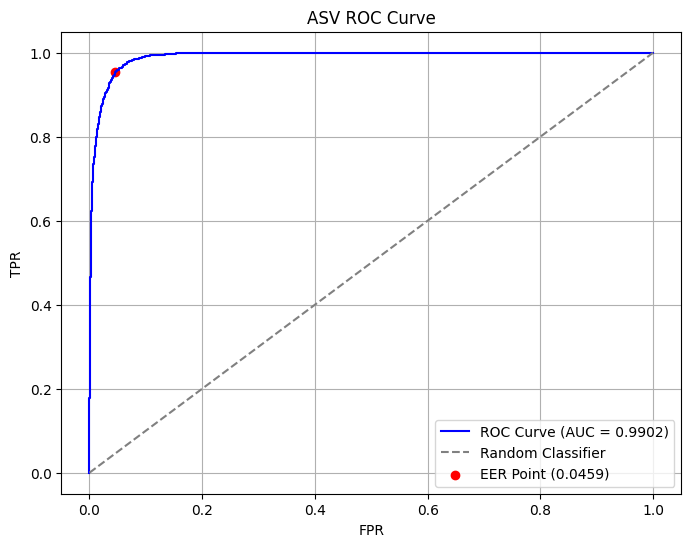

In [105]:
Test(test_loader, "ASV ")

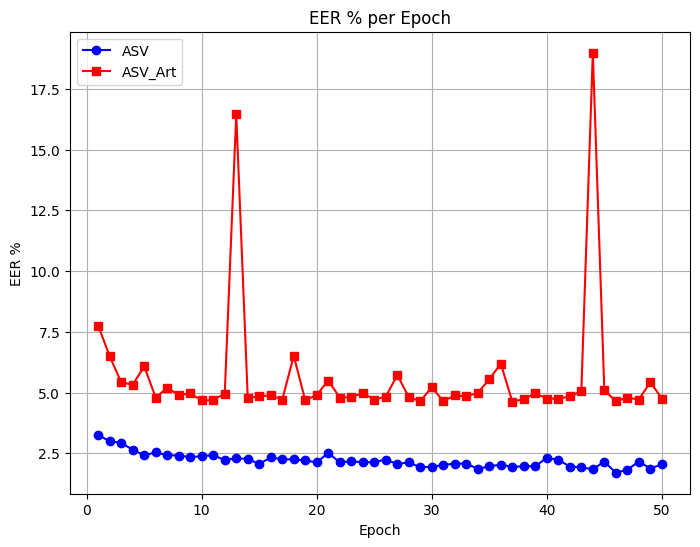

In [106]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs+1), [100*eer for eer in ASV_eer_per_epoch], marker='o', label="ASV", color='b')
plt.plot(range(1, num_epochs+1), [100*eer for eer in ASV_Art_eer_per_epoch], marker='s', label="ASV_Art", color='r')

plt.xlabel("Epoch")
plt.ylabel("EER %")
plt.title("EER % per Epoch")
plt.legend()
plt.grid(True)
plt.show()

In [48]:
with open("FoR_Train_Aug_Dataset.pkl", "rb") as f:
    for_train_data = pickle.load(f)

with open("FoR_Validation_Aug_Dataset.pkl", "rb") as f:
    for_val_data = pickle.load(f)

with open("FoR_Test_Aug_Dataset.pkl", "rb") as f:
    for_test_data = pickle.load(f)
        

FoR_train_dataset = DeepfakeDataset(for_train_data)
FoR_val_dataset = DeepfakeDataset(for_val_data)
FoR_test_dataset = DeepfakeDataset(for_test_data)

with open("ASV_Aug_Dataset.pkl", "rb") as f:
    data = pickle.load(f)

features = data["features"]
labels = data["labels"]

valid_indices = (labels == 0) | (labels == 1)

filtered_features = features[valid_indices]
filtered_labels = labels[valid_indices]

cleaned_data = {"features": filtered_features, "labels": filtered_labels}

dataset = DeepfakeDataset(cleaned_data)

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

ASV_train_dataset, ASV_val_dataset, ASV_test_dataset = random_split(dataset, [train_size, val_size, test_size])

In [49]:
Combined_train_dataset = torch.utils.data.ConcatDataset([ASV_train_dataset, FoR_train_dataset])
Combined_val_dataset = torch.utils.data.ConcatDataset([ASV_val_dataset, FoR_val_dataset])
Combined_test_dataset = torch.utils.data.ConcatDataset([ASV_test_dataset, FoR_test_dataset])

train_loader = DataLoader(Combined_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(Combined_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(Combined_test_dataset, batch_size=64, shuffle=False)

print(f"Training samples: {len(Combined_train_dataset)}, Validation samples: {len(Combined_val_dataset)}, Testing samples: {len(Combined_test_dataset)}")

Training samples: 222824, Validation samples: 35982, Testing samples: 23656


In [50]:
Combined_Art_eer_per_epoch = []
Train(train_loader, val_loader, Combined_Art_eer_per_epoch)

Epoch 1/50, Loss: 0.2187, Validate EER: 0.0779
Epoch 2/50, Loss: 0.1654, Validate EER: 0.0654
Epoch 3/50, Loss: 0.1479, Validate EER: 0.0558
Epoch 4/50, Loss: 0.1360, Validate EER: 0.0585
Epoch 5/50, Loss: 0.1281, Validate EER: 0.0489
Epoch 6/50, Loss: 0.1226, Validate EER: 0.0466
Epoch 7/50, Loss: 0.1170, Validate EER: 0.0622
Epoch 8/50, Loss: 0.1127, Validate EER: 0.0506
Epoch 9/50, Loss: 0.1090, Validate EER: 0.0518
Epoch 10/50, Loss: 0.1076, Validate EER: 0.0488
Epoch 11/50, Loss: 0.1116, Validate EER: 0.0511
Epoch 12/50, Loss: 0.1068, Validate EER: 0.0473
Epoch 13/50, Loss: 0.1063, Validate EER: 0.0428
Epoch 14/50, Loss: 0.1101, Validate EER: 0.0554
Epoch 15/50, Loss: 0.1139, Validate EER: 0.0724
Epoch 16/50, Loss: 0.1077, Validate EER: 0.0429
Epoch 17/50, Loss: 0.1062, Validate EER: 0.0545
Epoch 18/50, Loss: 0.1045, Validate EER: 0.0480
Epoch 19/50, Loss: 0.1030, Validate EER: 0.0409
Epoch 20/50, Loss: 0.1010, Validate EER: 0.0455
Epoch 21/50, Loss: 0.1000, Validate EER: 0.0494
E

Evaluation Metrics on Test Set:
Accuracy:  0.9383
Precision: 0.9057
Recall:    0.8488
F1 Score:  0.8763
FPR:       0.0306
FNR:       0.1512
EER:       0.0684


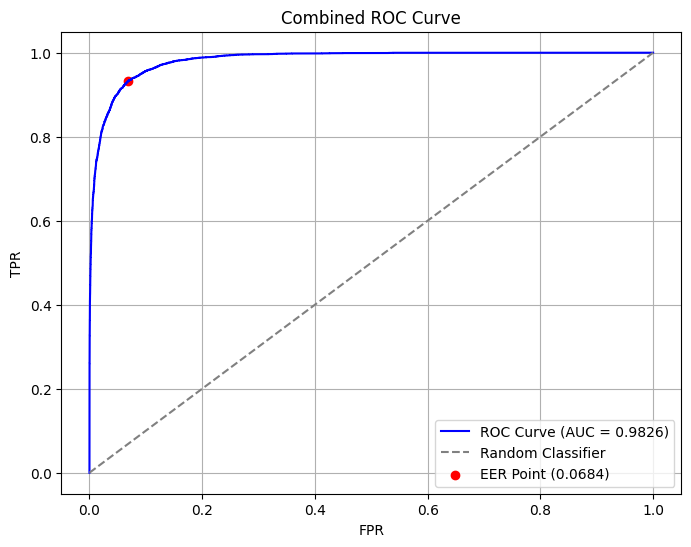

In [51]:
Test(test_loader, "Combined ")

# ResNet

In [5]:
class ResNetClassifier(nn.Module):
    def __init__(self, input_dim=1024, num_classes=2):
        super(ResNetClassifier, self).__init__()
        # Decide on H×W so that H*W = input_dim, e.g. 32×32 = 1024
        self.H = 32
        self.W = 32
        assert self.H * self.W == input_dim, "Choose H×W=input_dim"

        # Load pretrained ResNet-18
        self.resnet = models.resnet18(pretrained=True)
        # Adapt first conv to take 1 channel instead of 3
        self.resnet.conv1 = nn.Conv2d(
            in_channels=1,
            out_channels=self.resnet.conv1.out_channels,
            kernel_size=self.resnet.conv1.kernel_size,
            stride=self.resnet.conv1.stride,
            padding=self.resnet.conv1.padding,
            bias=False
        )
        # Replace final FC
        self.resnet.fc = nn.Linear(self.resnet.fc.in_features, num_classes)

    def forward(self, x):
        # x: (batch, input_dim)
        batch_size = x.size(0)
        # reshape into (batch, 1, H, W)
        x = x.view(batch_size, 1, self.H, self.W)
        # forward through ResNet
        logits = self.resnet(x)
        return logits

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = ResNetClassifier().to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
print(device)

/home/g7/Desktop/AML/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/g7/Desktop/AML/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /home/g7/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:26<00:00, 1.78MB/s]

cuda


In [35]:
with open("FoR_Train_Dataset.pkl", "rb") as f:
    for_train_data = pickle.load(f)

with open("FoR_Validation_Dataset.pkl", "rb") as f:
    for_val_data = pickle.load(f)

with open("FoR_Test_Dataset.pkl", "rb") as f:
    for_test_data = pickle.load(f)
        

FoR_train_dataset = DeepfakeDataset(for_train_data)
FoR_val_dataset = DeepfakeDataset(for_val_data)
FoR_test_dataset = DeepfakeDataset(for_test_data)

train_loader = DataLoader(FoR_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(FoR_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(FoR_test_dataset, batch_size=64, shuffle=False)


print(f"Training samples: {len(FoR_train_dataset)}, Validation samples: {len(FoR_val_dataset)}, Testing samples: {len(FoR_test_dataset)}")

Training samples: 53866, Validation samples: 10798, Testing samples: 4634


In [36]:
FoR_eer_per_epoch = []
Train(train_loader, val_loader, FoR_eer_per_epoch)

Epoch 1/50, Loss: 0.0071, Test EER: 0.0163
Epoch 2/50, Loss: 0.0030, Test EER: 0.0161
Epoch 3/50, Loss: 0.0039, Test EER: 0.0167
Epoch 4/50, Loss: 0.0051, Test EER: 0.0172
Epoch 5/50, Loss: 0.0043, Test EER: 0.0182
Epoch 6/50, Loss: 0.0045, Test EER: 0.0150
Epoch 7/50, Loss: 0.0040, Test EER: 0.0156
Epoch 8/50, Loss: 0.0040, Test EER: 0.0163
Epoch 9/50, Loss: 0.0042, Test EER: 0.0161
Epoch 10/50, Loss: 0.0025, Test EER: 0.0159
Epoch 11/50, Loss: 0.0035, Test EER: 0.0165
Epoch 12/50, Loss: 0.0042, Test EER: 0.0144
Epoch 13/50, Loss: 0.0027, Test EER: 0.0182
Epoch 14/50, Loss: 0.0039, Test EER: 0.0174
Epoch 15/50, Loss: 0.0036, Test EER: 0.0163
Epoch 16/50, Loss: 0.0020, Test EER: 0.0133
Epoch 17/50, Loss: 0.0033, Test EER: 0.0141
Epoch 18/50, Loss: 0.0030, Test EER: 0.0137
Epoch 19/50, Loss: 0.0040, Test EER: 0.0146
Epoch 20/50, Loss: 0.0022, Test EER: 0.0157
Epoch 21/50, Loss: 0.0029, Test EER: 0.0143
Epoch 22/50, Loss: 0.0027, Test EER: 0.0169
Epoch 23/50, Loss: 0.0029, Test EER: 0.01

Evaluation Metrics on Test Set:
Accuracy:  0.9657
Precision: 0.9519
Recall:    0.9792
F1 Score:  0.9654
FPR:       0.0473
FNR:       0.0208
EER:       0.0346


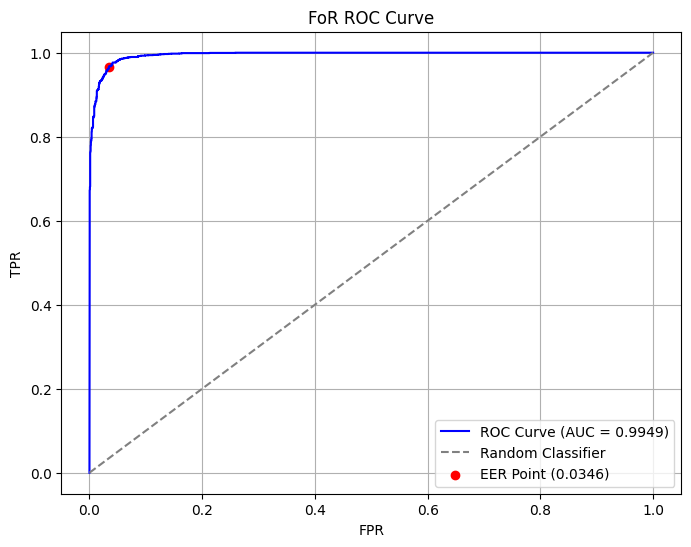

In [37]:
Test(test_loader, "FoR ")

In [16]:
with open("ASV_Dataset.pkl", "rb") as f:
    data = pickle.load(f)

features = data["features"]
labels = data["labels"]

valid_indices = (labels == 0) | (labels == 1)

filtered_features = features[valid_indices]
filtered_labels = labels[valid_indices]

cleaned_data = {"features": filtered_features, "labels": filtered_labels}
print(filtered_features.shape)
print(filtered_labels.shape)

(71237, 1024)
(71237,)


In [17]:
dataset = DeepfakeDataset(cleaned_data)

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

ASV_train_dataset, ASV_val_dataset, ASV_test_dataset = random_split(dataset, [train_size, val_size, test_size])

train_loader = DataLoader(ASV_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(ASV_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(ASV_test_dataset, batch_size=64, shuffle=False)

print(f"Training samples: {train_size}, Validation samples: {val_size}, Testing samples: {test_size}")

Training samples: 56989, Validation samples: 7123, Testing samples: 7125


In [18]:
ASV_eer_per_epoch = []
Train(train_loader, val_loader, ASV_eer_per_epoch)

Epoch 1/50, Loss: 0.2135, Test EER: 0.0514
Epoch 2/50, Loss: 0.0859, Test EER: 0.0403
Epoch 3/50, Loss: 0.0702, Test EER: 0.0495
Epoch 4/50, Loss: 0.0634, Test EER: 0.0333
Epoch 5/50, Loss: 0.0594, Test EER: 0.0304
Epoch 6/50, Loss: 0.0546, Test EER: 0.0373
Epoch 7/50, Loss: 0.0503, Test EER: 0.0252
Epoch 8/50, Loss: 0.0489, Test EER: 0.0259
Epoch 9/50, Loss: 0.0454, Test EER: 0.0255
Epoch 10/50, Loss: 0.0434, Test EER: 0.0233
Epoch 11/50, Loss: 0.0430, Test EER: 0.0223
Epoch 12/50, Loss: 0.0407, Test EER: 0.0256
Epoch 13/50, Loss: 0.0396, Test EER: 0.1079
Epoch 14/50, Loss: 0.0367, Test EER: 0.0256
Epoch 15/50, Loss: 0.0395, Test EER: 0.0228
Epoch 16/50, Loss: 0.0358, Test EER: 0.0326
Epoch 17/50, Loss: 0.0350, Test EER: 0.0233
Epoch 18/50, Loss: 0.0354, Test EER: 0.0192
Epoch 19/50, Loss: 0.0342, Test EER: 0.0204
Epoch 20/50, Loss: 0.0321, Test EER: 0.0214
Epoch 21/50, Loss: 0.0327, Test EER: 0.0217
Epoch 22/50, Loss: 0.0311, Test EER: 0.0244
Epoch 23/50, Loss: 0.0315, Test EER: 0.02

Evaluation Metrics on Test Set:
Accuracy:  0.9886
Precision: 0.9779
Recall:    0.9095
F1 Score:  0.9424
FPR:       0.0023
FNR:       0.0905
EER:       0.0183


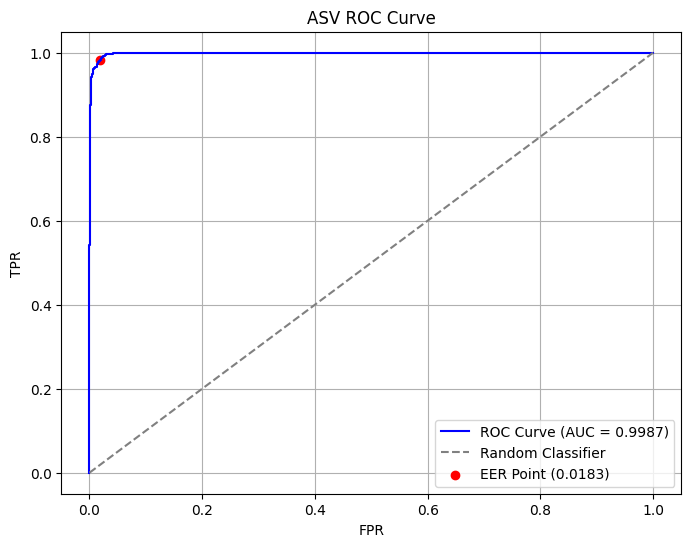

In [19]:
Test(test_loader, "ASV ")

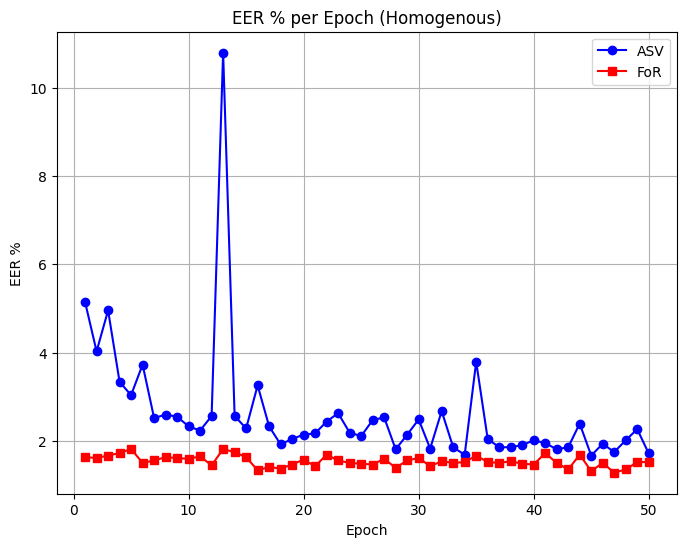

In [38]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs+1), [100*eer for eer in ASV_eer_per_epoch], marker='o', label="ASV", color='b')
plt.plot(range(1, num_epochs+1), [100*eer for eer in FoR_eer_per_epoch], marker='s', label="FoR", color='r')

plt.xlabel("Epoch")
plt.ylabel("EER %")
plt.title("EER % per Epoch (Homogenous)")
plt.legend()
plt.grid(True)
plt.show()

In [21]:
with open("FoR_Train_Aug_Dataset.pkl", "rb") as f:
    for_train_data = pickle.load(f)

with open("FoR_Validation_Aug_Dataset.pkl", "rb") as f:
    for_val_data = pickle.load(f)

with open("FoR_Test_Aug_Dataset.pkl", "rb") as f:
    for_test_data = pickle.load(f)
        

FoR_train_dataset = DeepfakeDataset(for_train_data)
FoR_val_dataset = DeepfakeDataset(for_val_data)
FoR_test_dataset = DeepfakeDataset(for_test_data)

train_loader = DataLoader(FoR_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(FoR_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(FoR_test_dataset, batch_size=64, shuffle=False)


print(f"Training samples: {len(FoR_train_dataset)}, Validation samples: {len(FoR_val_dataset)}, Testing samples: {len(FoR_test_dataset)}")

Training samples: 107732, Validation samples: 21596, Testing samples: 9268


In [22]:
FoR_Art_eer_per_epoch = []
Train(train_loader, val_loader, FoR_Art_eer_per_epoch)

Epoch 1/50, Loss: 0.1684, Test EER: 0.0454
Epoch 2/50, Loss: 0.0925, Test EER: 0.0418
Epoch 3/50, Loss: 0.0790, Test EER: 0.0361
Epoch 4/50, Loss: 0.0707, Test EER: 0.0357
Epoch 5/50, Loss: 0.0663, Test EER: 0.0308
Epoch 6/50, Loss: 0.0602, Test EER: 0.0299
Epoch 7/50, Loss: 0.0665, Test EER: 0.0340
Epoch 8/50, Loss: 0.0536, Test EER: 0.0321
Epoch 9/50, Loss: 0.0520, Test EER: 0.0344
Epoch 10/50, Loss: 0.0511, Test EER: 0.0363
Epoch 11/50, Loss: 0.0478, Test EER: 0.0293
Epoch 12/50, Loss: 0.0464, Test EER: 0.0288
Epoch 13/50, Loss: 0.0454, Test EER: 0.0313
Epoch 14/50, Loss: 0.0445, Test EER: 0.0311
Epoch 15/50, Loss: 0.0424, Test EER: 0.0284
Epoch 16/50, Loss: 0.0406, Test EER: 0.0269
Epoch 17/50, Loss: 0.0409, Test EER: 0.0281
Epoch 18/50, Loss: 0.0395, Test EER: 0.0277
Epoch 19/50, Loss: 0.0421, Test EER: 0.0299
Epoch 20/50, Loss: 0.0381, Test EER: 0.0273
Epoch 21/50, Loss: 0.0414, Test EER: 0.0292
Epoch 22/50, Loss: 0.0362, Test EER: 0.0320
Epoch 23/50, Loss: 0.0361, Test EER: 0.02

Evaluation Metrics on Test Set:
Accuracy:  0.9188
Precision: 0.9413
Recall:    0.8891
F1 Score:  0.9145
FPR:       0.0530
FNR:       0.1109
EER:       0.0741


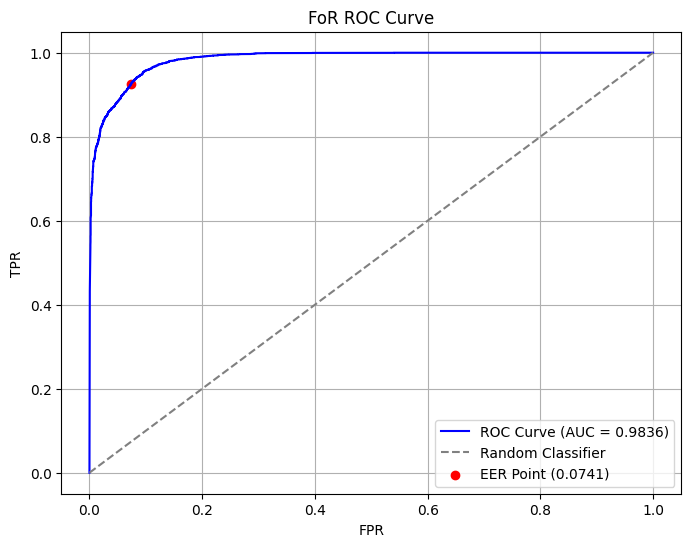

In [23]:
Test(test_loader, "FoR ")

In [24]:
with open("ASV_Aug_Dataset.pkl", "rb") as f:
    data = pickle.load(f)

features = data["features"]
labels = data["labels"]

valid_indices = (labels == 0) | (labels == 1)

filtered_features = features[valid_indices]
filtered_labels = labels[valid_indices]

cleaned_data = {"features": filtered_features, "labels": filtered_labels}
print(filtered_features.shape)
print(filtered_labels.shape)

(143866, 1024)
(143866,)


In [25]:
Aug_dataset = DeepfakeDataset(cleaned_data)

train_size = int(0.8 * len(Aug_dataset))
val_size = int(0.1 * len(Aug_dataset))
test_size = len(Aug_dataset) - train_size - val_size

ASV_Art_train_dataset, ASV_Art_val_dataset, ASV_Art_test_dataset = random_split(Aug_dataset, [train_size, val_size, test_size])

train_loader = DataLoader(ASV_Art_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(ASV_Art_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(ASV_Art_test_dataset, batch_size=64, shuffle=False)

print(f"Training samples: {train_size}, Validation samples: {val_size}, Testing samples: {test_size}")

Training samples: 115092, Validation samples: 14386, Testing samples: 14388


In [26]:
ASV_Art_eer_per_epoch = []
Train(train_loader, val_loader, ASV_Art_eer_per_epoch)

Epoch 1/50, Loss: 0.1528, Test EER: 0.1124
Epoch 2/50, Loss: 0.0931, Test EER: 0.0710
Epoch 3/50, Loss: 0.0825, Test EER: 0.0531
Epoch 4/50, Loss: 0.0757, Test EER: 0.0547
Epoch 5/50, Loss: 0.0714, Test EER: 0.0498
Epoch 6/50, Loss: 0.0691, Test EER: 0.0466
Epoch 7/50, Loss: 0.0645, Test EER: 0.0396
Epoch 8/50, Loss: 0.0710, Test EER: 0.0480
Epoch 9/50, Loss: 0.0618, Test EER: 0.0400
Epoch 10/50, Loss: 0.0579, Test EER: 0.0545
Epoch 11/50, Loss: 0.0572, Test EER: 0.0391
Epoch 12/50, Loss: 0.0564, Test EER: 0.0474
Epoch 13/50, Loss: 0.0545, Test EER: 0.0448
Epoch 14/50, Loss: 0.0520, Test EER: 0.0406
Epoch 15/50, Loss: 0.0505, Test EER: 0.0428
Epoch 16/50, Loss: 0.0504, Test EER: 0.0401
Epoch 17/50, Loss: 0.0485, Test EER: 0.0368
Epoch 18/50, Loss: 0.0473, Test EER: 0.0425
Epoch 19/50, Loss: 0.0476, Test EER: 0.0374
Epoch 20/50, Loss: 0.0482, Test EER: 0.0396
Epoch 21/50, Loss: 0.0449, Test EER: 0.0433
Epoch 22/50, Loss: 0.0437, Test EER: 0.0423
Epoch 23/50, Loss: 0.0427, Test EER: 0.04

Evaluation Metrics on Test Set:
Accuracy:  0.9750
Precision: 0.8495
Recall:    0.9448
F1 Score:  0.8946
FPR:       0.0211
FNR:       0.0552
EER:       0.0326


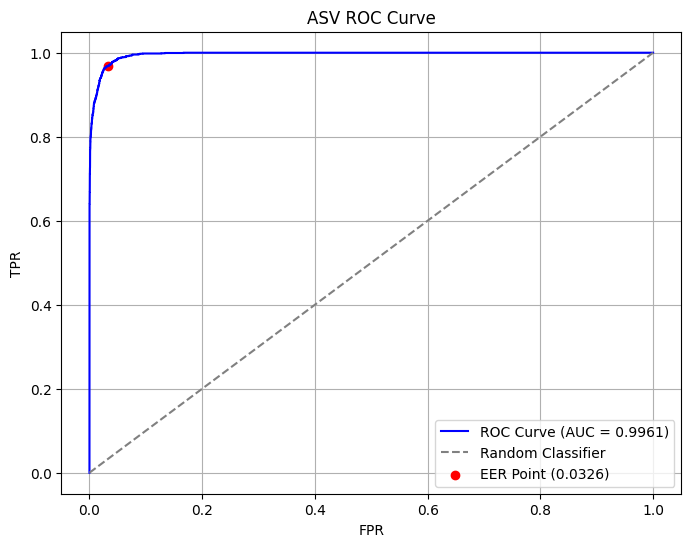

In [27]:
Test(test_loader, "ASV ")

# Combined

Without Artifacts

In [ ]:
with open("FoR_Train_Dataset.pkl", "rb") as f:
    for_train_data = pickle.load(f)

with open("FoR_Validation_Dataset.pkl", "rb") as f:
    for_val_data = pickle.load(f)

with open("FoR_Test_Dataset.pkl", "rb") as f:
    for_test_data = pickle.load(f)
        

FoR_train_dataset = DeepfakeDataset(for_train_data)
FoR_val_dataset = DeepfakeDataset(for_val_data)
FoR_test_dataset = DeepfakeDataset(for_test_data)

with open("ASV_Dataset.pkl", "rb") as f:
    data = pickle.load(f)

features = data["features"]
labels = data["labels"]

valid_indices = (labels == 0) | (labels == 1)

filtered_features = features[valid_indices]
filtered_labels = labels[valid_indices]

cleaned_data = {"features": filtered_features, "labels": filtered_labels}

dataset = DeepfakeDataset(cleaned_data)

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

ASV_train_dataset, ASV_val_dataset, ASV_test_dataset = random_split(dataset, [train_size, val_size, test_size])

In [30]:
Combined_train_dataset = torch.utils.data.ConcatDataset([ASV_train_dataset, FoR_train_dataset])
Combined_val_dataset = torch.utils.data.ConcatDataset([ASV_val_dataset, FoR_val_dataset])
Combined_test_dataset = torch.utils.data.ConcatDataset([ASV_test_dataset, FoR_test_dataset])

train_loader = DataLoader(Combined_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(Combined_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(Combined_test_dataset, batch_size=64, shuffle=False)

print(f"Training samples: {len(Combined_train_dataset)}, Validation samples: {len(Combined_val_dataset)}, Testing samples: {len(Combined_test_dataset)}")

Training samples: 110855, Validation samples: 17921, Testing samples: 16393


In [31]:
Comb_eer_per_epoch = []
Train(train_loader, val_loader, Comb_eer_per_epoch)

Epoch 1/50, Loss: 0.0973, Test EER: 0.0278
Epoch 2/50, Loss: 0.0483, Test EER: 0.0217
Epoch 3/50, Loss: 0.0398, Test EER: 0.0200
Epoch 4/50, Loss: 0.0352, Test EER: 0.0224
Epoch 5/50, Loss: 0.0295, Test EER: 0.0205
Epoch 6/50, Loss: 0.0265, Test EER: 0.0177
Epoch 7/50, Loss: 0.0262, Test EER: 0.0222
Epoch 8/50, Loss: 0.0222, Test EER: 0.0182
Epoch 9/50, Loss: 0.0212, Test EER: 0.0189
Epoch 10/50, Loss: 0.0199, Test EER: 0.0220
Epoch 11/50, Loss: 0.0169, Test EER: 0.0172
Epoch 12/50, Loss: 0.0179, Test EER: 0.0153
Epoch 13/50, Loss: 0.0164, Test EER: 0.0357
Epoch 14/50, Loss: 0.0151, Test EER: 0.0184
Epoch 15/50, Loss: 0.0161, Test EER: 0.0174
Epoch 16/50, Loss: 0.0150, Test EER: 0.0172
Epoch 17/50, Loss: 0.0134, Test EER: 0.0178
Epoch 18/50, Loss: 0.0135, Test EER: 0.0177
Epoch 19/50, Loss: 0.0131, Test EER: 0.0193
Epoch 20/50, Loss: 0.0141, Test EER: 0.0163
Epoch 21/50, Loss: 0.0123, Test EER: 0.0175
Epoch 22/50, Loss: 0.0139, Test EER: 0.0163
Epoch 23/50, Loss: 0.0128, Test EER: 0.01

Evaluation Metrics on Test Set:
Accuracy:  0.9682
Precision: 0.9114
Recall:    0.9705
F1 Score:  0.9401
FPR:       0.0326
FNR:       0.0295
EER:       0.0311


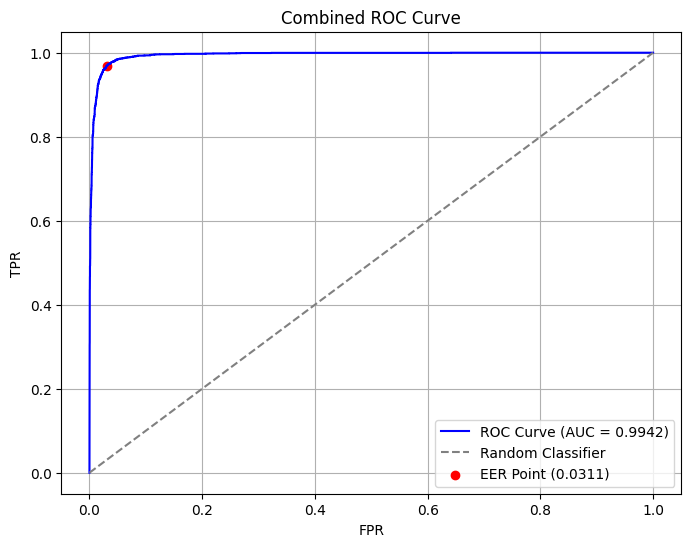

In [34]:
Test(test_loader, "Combined ")

With Artifacts

In [45]:
with open("FoR_Train_Aug_Dataset.pkl", "rb") as f:
    for_train_data = pickle.load(f)

with open("FoR_Validation_Aug_Dataset.pkl", "rb") as f:
    for_val_data = pickle.load(f)

with open("FoR_Test_Aug_Dataset.pkl", "rb") as f:
    for_test_data = pickle.load(f)
        

FoR_train_dataset = DeepfakeDataset(for_train_data)
FoR_val_dataset = DeepfakeDataset(for_val_data)
FoR_test_dataset = DeepfakeDataset(for_test_data)

with open("ASV_Aug_Dataset.pkl", "rb") as f:
    data = pickle.load(f)

features = data["features"]
labels = data["labels"]

valid_indices = (labels == 0) | (labels == 1)

filtered_features = features[valid_indices]
filtered_labels = labels[valid_indices]

cleaned_data = {"features": filtered_features, "labels": filtered_labels}

dataset = DeepfakeDataset(cleaned_data)

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

ASV_train_dataset, ASV_val_dataset, ASV_test_dataset = random_split(dataset, [train_size, val_size, test_size])

In [46]:
Combined_train_dataset = torch.utils.data.ConcatDataset([ASV_train_dataset, FoR_train_dataset])
Combined_val_dataset = torch.utils.data.ConcatDataset([ASV_val_dataset, FoR_val_dataset])
Combined_test_dataset = torch.utils.data.ConcatDataset([ASV_test_dataset, FoR_test_dataset])

train_loader = DataLoader(Combined_train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(Combined_val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(Combined_test_dataset, batch_size=64, shuffle=False)

print(f"Training samples: {len(Combined_train_dataset)}, Validation samples: {len(Combined_val_dataset)}, Testing samples: {len(Combined_test_dataset)}")

Training samples: 222824, Validation samples: 35982, Testing samples: 23656


In [42]:
Comb_Art_eer_per_epoch = []
Train(train_loader, val_loader, Comb_Art_eer_per_epoch)

Epoch 1/50, Loss: 0.0858, Test EER: 0.0401
Epoch 2/50, Loss: 0.0625, Test EER: 0.0348
Epoch 3/50, Loss: 0.0560, Test EER: 0.0327
Epoch 4/50, Loss: 0.0522, Test EER: 0.0326
Epoch 5/50, Loss: 0.0497, Test EER: 0.0316
Epoch 6/50, Loss: 0.0471, Test EER: 0.0322
Epoch 7/50, Loss: 0.0458, Test EER: 0.0504
Epoch 8/50, Loss: 0.0442, Test EER: 0.0311
Epoch 9/50, Loss: 0.0437, Test EER: 0.0300
Epoch 10/50, Loss: 0.0420, Test EER: 0.0331
Epoch 11/50, Loss: 0.0407, Test EER: 0.0289
Epoch 12/50, Loss: 0.0400, Test EER: 0.0307
Epoch 13/50, Loss: 0.0388, Test EER: 0.0333
Epoch 14/50, Loss: 0.0397, Test EER: 0.0330
Epoch 15/50, Loss: 0.0370, Test EER: 0.0359
Epoch 16/50, Loss: 0.0365, Test EER: 0.0370
Epoch 17/50, Loss: 0.0365, Test EER: 0.0311
Epoch 18/50, Loss: 0.0375, Test EER: 0.0309
Epoch 19/50, Loss: 0.0350, Test EER: 0.0291
Epoch 20/50, Loss: 0.0348, Test EER: 0.0289
Epoch 21/50, Loss: 0.0344, Test EER: 0.0286
Epoch 22/50, Loss: 0.0338, Test EER: 0.0301
Epoch 23/50, Loss: 0.0333, Test EER: 0.03

Evaluation Metrics on Test Set:
Accuracy:  0.9536
Precision: 0.8950
Recall:    0.9267
F1 Score:  0.9106
FPR:       0.0372
FNR:       0.0733
EER:       0.0506


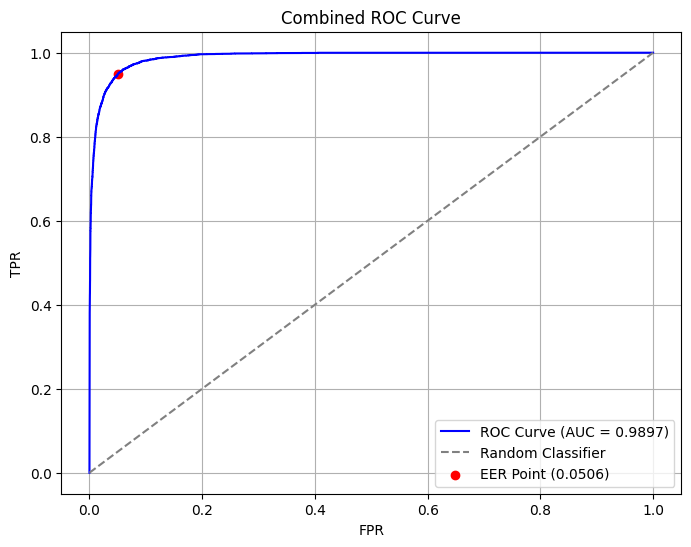

In [43]:
Test(test_loader, "Combined ")

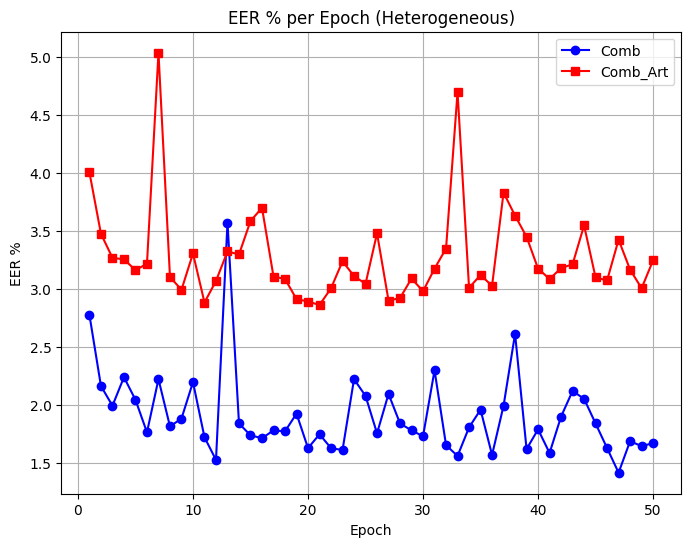

In [45]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs+1), [100*eer for eer in Comb_eer_per_epoch], marker='o', label="Comb", color='b')
plt.plot(range(1, num_epochs+1), [100*eer for eer in Comb_Art_eer_per_epoch], marker='s', label="Comb_Art", color='r')
plt.xlabel("Epoch")
plt.ylabel("EER %")
plt.title("EER % per Epoch (Heterogeneous)")
plt.legend()
plt.grid(True)
plt.show()

Combined_Art-Base

Epoch 1/50, Loss: 0.1952, Validate EER: 0.0745
Epoch 2/50, Loss: 0.1596, Validate EER: 0.0632
Epoch 3/50, Loss: 0.1442, Validate EER: 0.0581
Epoch 4/50, Loss: 0.1345, Validate EER: 0.0563
Epoch 5/50, Loss: 0.1281, Validate EER: 0.0646
Epoch 6/50, Loss: 0.1221, Validate EER: 0.0504
Epoch 7/50, Loss: 0.1177, Validate EER: 0.0478
Epoch 8/50, Loss: 0.1136, Validate EER: 0.0479
Epoch 9/50, Loss: 0.1122, Validate EER: 0.0536
Epoch 10/50, Loss: 0.1093, Validate EER: 0.0563
Epoch 11/50, Loss: 0.1061, Validate EER: 0.0457
Epoch 12/50, Loss: 0.1037, Validate EER: 0.0488
Epoch 13/50, Loss: 0.1028, Validate EER: 0.0518
Epoch 14/50, Loss: 0.1013, Validate EER: 0.0486
Epoch 15/50, Loss: 0.0978, Validate EER: 0.0494
Epoch 16/50, Loss: 0.0973, Validate EER: 0.0408
Epoch 17/50, Loss: 0.0948, Validate EER: 0.0430
Epoch 18/50, Loss: 0.0946, Validate EER: 0.0533
Epoch 19/50, Loss: 0.0930, Validate EER: 0.0410
Epoch 20/50, Loss: 0.0913, Validate EER: 0.0393
Epoch 21/50, Loss: 0.0900, Validate EER: 0.0402
E

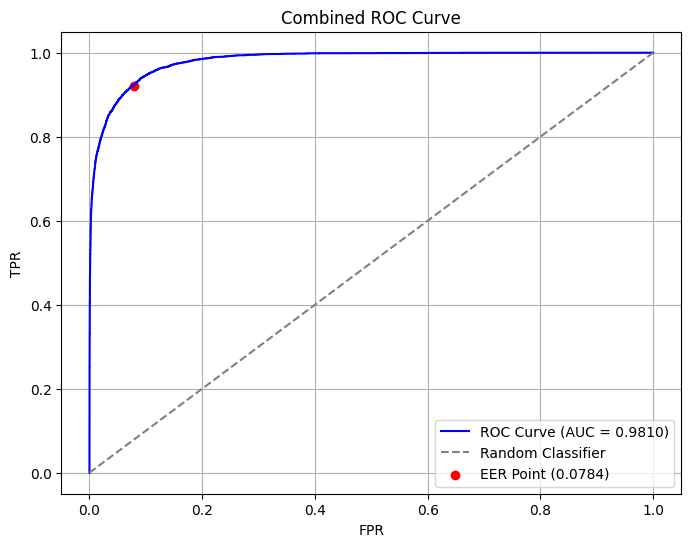

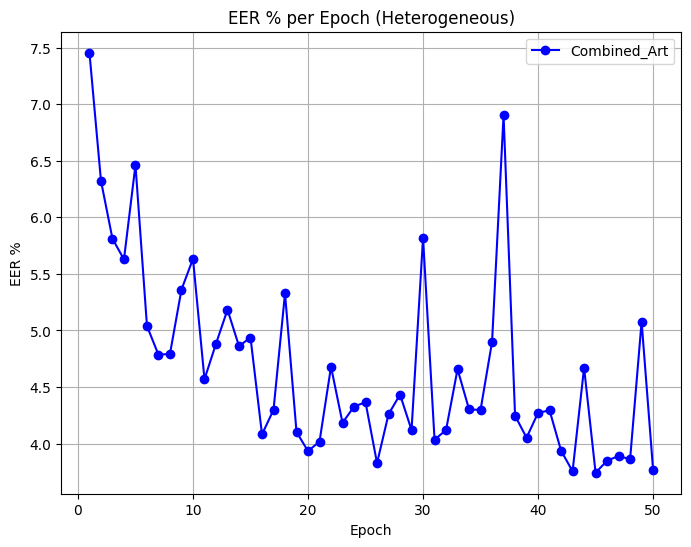

In [53]:
Combined_Art_eer_per_epoch = []
Train(train_loader, val_loader, Combined_Art_eer_per_epoch)
Test(test_loader, "Combined ")

plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs+1), [100*eer for eer in Combined_Art_eer_per_epoch], marker='o', label="Combined_Art", color='b')
plt.xlabel("Epoch")
plt.ylabel("EER %")
plt.title("EER % per Epoch (Heterogeneous)")
plt.legend()
plt.grid(True)
plt.show()

# All Layers

In [10]:
audio_folder = "ASV/Data"
protocol_file = "ASV/Labels.txt" 

ASV_files = [f for f in os.listdir(audio_folder) if f.endswith(".flac")]
print(f"Found {len(asv_files)} audio files.")

random_files = random.sample(asv_files, min(5, len(asv_files)))
print("Randomly sampled filenames:")
for filename in random_files:
    print(filename)

Found 71933 audio files.
Randomly sampled filenames:
LA_E_8160413.flac
LA_E_8424647.flac
LA_E_2132461.flac
LA_E_6135912.flac
LA_E_3377577.flac


In [11]:
label_dict = {}
with open(protocol_file, "r") as f:
    for line in f:
        parts = line.strip().split()
        if len(parts) < 5:
            continue
        _, filename, _, _, label = parts
        label_dict[filename] = 1 if label == "bonafide" else 0
print(f"Label dictionary created with {len(label_dict)} labels.")

Label dictionary created with 71237 labels.


In [12]:
ASV_files = [os.path.join(audio_folder, f) for f in os.listdir(audio_folder) if f.endswith(".flac")]

ASV_labels = []
for file in ASV_files:
    filename = os.path.basename(file)
    name_without_ext = os.path.splitext(filename)[0]
    
    if filename.endswith(".flac"):
        base_name = name_without_ext
    else:
        base_name = "_".join(name_without_ext.split("_")[:-1])
    
    label = label_dict.get(base_name, None)
    
    if label is not None:
        ASV_labels.append(label)

    else:
        ASV_labels.append(random.randint(0, 1))
        print(f"Warning: No label found for file {base_name} Skipping.")

print(f"Total files: {len(ASV_files)}, Total labels: {len(ASV_labels)}")

Total files: 71933, Total labels: 71933


In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
processor = AutoProcessor.from_pretrained("facebook/hubert-large-ls960-ft")
model = HubertModel.from_pretrained("facebook/hubert-large-ls960-ft", output_hidden_states=True).to(device)
model.eval()
print(device)

cuda


In [31]:
BATCH_SIZE = 64
def process_batch(filenames):
    waveforms = []
    successful_files = []
    for filename in filenames:
        try:
            waveform, sample_rate = torchaudio.load(filename)
            waveform = waveform.to(device)
            if sample_rate != 16000:
                waveform = torchaudio.transforms.Resample(sample_rate, 16000)(waveform)
            if waveform.size(0) > 1:
                waveform = waveform.mean(dim=0, keepdim=True)
            waveforms.append(waveform.squeeze(0))
            successful_files.append(filename)

    
        except RuntimeError as e:
                print(f"Error loading {filename}: {e}")
                continue

    batch_features = []
    with torch.no_grad():
        for waveform in waveforms:
            inputs = processor(waveform, sampling_rate=16000, return_tensors="pt").to(device)
            outputs = model(**inputs)
            hidden_states = outputs.hidden_states[1:]
            pooled = [hs.mean(dim=1).squeeze(0).cpu().numpy() for hs in hidden_states]
            batch_features.append(np.stack(pooled, axis=0))

    return batch_features, successful_files

def get_pkl(files, labels, output_file):
    features, filtered_labels = [], []
    
    for i in tqdm(range(0, len(files), BATCH_SIZE), desc="Extracting features"):
        batch_files = files[i:i + BATCH_SIZE]
        batch_labels = labels[i:i + BATCH_SIZE]
        
        batch_features, successful_files = process_batch(batch_files)
        
        successful_indices = [batch_files.index(file) for file in successful_files]
        filtered_batch_labels = [batch_labels[idx] for idx in successful_indices]
        
        features.extend(batch_features)
        filtered_labels.extend(filtered_batch_labels)

    features = np.array(features, dtype=np.float32)
    filtered_labels = np.array(filtered_labels, dtype=np.int8)

    with open(output_file, "wb") as f:
        pickle.dump({"features": features, "labels": filtered_labels}, f)

    print(f"Saved extracted features to {output_file}")
    print(f"Features: {len(features)}, Labels: {len(filtered_labels)}")

In [22]:
get_pkl(ASV_files, ASV_labels, "ASV_AL_Dataset.pkl")

Extracting features: 100%|██████████| 1124/1124 [21:33<00:00,  1.15s/it]


Saved extracted features to ASV_AL_Dataset.pkl


In [23]:
real_audio_folder = "FoR/training/real"
fake_audio_folder = "FoR/training/fake"

real_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

for_train_files = real_files + fake_files

real_label = [1] * len(real_files)  
fake_label = [0] * len(fake_files)

train_labels = np.array(real_label + fake_label, dtype=np.int8)

real_audio_folder = "FoR/testing/real"
fake_audio_folder = "FoR/testing/fake"

real_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

for_testing_files = real_files + fake_files

real_label = [1] * len(real_files)  
fake_label = [0] * len(fake_files)

test_labels = np.array(real_label + fake_label, dtype=np.int8)

real_audio_folder = "FoR/validation/real"
fake_audio_folder = "FoR/validation/fake"

real_files = [os.path.join(real_audio_folder, f) for f in os.listdir(real_audio_folder) if f.endswith(".wav")]
fake_files = [os.path.join(fake_audio_folder, f) for f in os.listdir(fake_audio_folder) if f.endswith(".wav")]

for_validation_files = real_files + fake_files

real_label = [1] * len(real_files)  
fake_label = [0] * len(fake_files)

validation_labels = np.array(real_label + fake_label, dtype=np.int8)

In [32]:
get_pkl(for_train_files, train_labels, "FoR_Train_AL_Dataset.pkl")
get_pkl(for_testing_files, test_labels, "FoR_Test_AL_Dataset.pkl")
get_pkl(for_validation_files, validation_labels, "FoR_Validation_AL_Dataset.pkl")

Extracting features:  10%|█         | 85/842 [02:21<20:39,  1.64s/it]

Error loading FoR/training/real/file11064.wav_16k.wav_norm.wav_mono.wav_silence.wav: Failed to decode audio.


Extracting features:  36%|███▋      | 306/842 [08:31<15:24,  1.72s/it]

Error loading FoR/training/real/file15440.wav_16k.wav_norm.wav_mono.wav_silence.wav: Failed to decode audio.


Extracting features: 100%|██████████| 842/842 [18:19<00:00,  1.31s/it]


Saved extracted features to FoR_Train_AL_Dataset.pkl
Features: 53866, Labels: 53866


Extracting features: 100%|██████████| 73/73 [01:17<00:00,  1.06s/it]


Saved extracted features to FoR_Test_AL_Dataset.pkl
Features: 4634, Labels: 4634


Extracting features: 100%|██████████| 169/169 [03:40<00:00,  1.31s/it]


Saved extracted features to FoR_Validation_AL_Dataset.pkl
Features: 10798, Labels: 10798


In [19]:
class LayerFeatureDataset(Dataset):
    def __init__(self, pkl_path):
        data = pickle.load(open(pkl_path, 'rb'))
        self.X = torch.tensor(data['features'], dtype=torch.float32)  
        self.y = torch.tensor(data['labels'],   dtype=torch.long)    
    def __len__(self):
        return len(self.y)
    def __getitem__(self, i):
        return self.X[i], self.y[i]

class LayerWeightedAggregator(nn.Module):
    def __init__(self, num_layers):
        super().__init__()
        self.w = nn.Parameter(torch.ones(num_layers) / num_layers)
    def forward(self, x):
        w = torch.softmax(self.w, dim=0)             
        return (x * w[None, :, None]).sum(dim=1)     

class MaxFeatureMap1D(nn.Module):
    def forward(self, x):
        out = x.view(x.size(0), x.size(1) // 2, 2, x.size(2))
        out = out.max(dim=2)[0]
        return out
        
class DeepfakeClassifier(nn.Module):
    def __init__(self, num_layers, input_dim=1024, hidden_dim=512, lstm_hidden_dim=256, num_classes=2):
        super().__init__()
        self.agg = LayerWeightedAggregator(num_layers)
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.relu = nn.ReLU()

        self.conv1 = nn.Conv1d(1, 64, 5, 1, padding=2)
        self.mfm1 = MaxFeatureMap1D()
        self.pool1 = nn.AdaptiveMaxPool1d(output_size=16)
        self.conv2 = nn.Conv1d(32, 64, 1)
        self.mfm2 = MaxFeatureMap1D()
        self.batchnorm1 = nn.BatchNorm1d(32)
        self.conv3 = nn.Conv1d(32,96,3,1,1)
        self.mfm3 = MaxFeatureMap1D()
        self.pool2 = self.pool2 = nn.AdaptiveMaxPool1d(output_size=8)
        self.batchnorm2 = nn.BatchNorm1d(48)
        self.conv4 = nn.Conv1d(48,96,1)
        self.mfm4 = MaxFeatureMap1D()
        self.batchnorm3 = nn.BatchNorm1d(48)
        self.conv5 = nn.Conv1d(48,128,3,1,1)
        self.mfm5 = MaxFeatureMap1D()
        self.pool3 = nn.AdaptiveMaxPool1d(output_size=4)

        self.lstm1 = nn.LSTM(64, lstm_hidden_dim, 1, bidirectional=True, batch_first=True)
        self.lstm2 = nn.LSTM(lstm_hidden_dim*2, lstm_hidden_dim, 1, bidirectional=True, batch_first=True)

        self.gap = nn.AdaptiveAvgPool1d(1)
        self.fc2 = nn.Linear(lstm_hidden_dim*2, num_classes)

    def forward(self, x):
        x = self.agg(x)               
        x = self.fc1(x)
        x = self.relu(x)

        x = x.unsqueeze(1)            
        x = self.conv1(x); x=self.mfm1(x); x=self.pool1(x)
        x = self.conv2(x); x=self.mfm2(x); x=self.batchnorm1(x)
        x = self.conv3(x); x=self.mfm3(x); x=self.pool2(x)
        x = self.batchnorm2(x)
        x = self.conv4(x); x=self.mfm4(x); x=self.batchnorm3(x)
        x = self.conv5(x); x=self.mfm5(x); x=self.pool3(x)

        x = x.permute(0,2,1)          
        x,_ = self.lstm1(x)
        x,_ = self.lstm2(x)

        x = x.permute(0,2,1)         
        x = self.gap(x).squeeze(-1)
        return self.fc2(x)

In [3]:
class ResNetClassifier(nn.Module):
    def __init__(self, num_layers, hidden_dim, num_classes):
        super().__init__()
        self.agg = LayerWeightedAggregator(num_layers)
        H = W = int(np.sqrt(hidden_dim))
        assert H*W == hidden_dim, "hidden_dim must be square"
        self.H, self.W = H, W

        self.resnet = models.resnet18(pretrained=True)
        self.resnet.conv1 = nn.Conv2d(1,
            self.resnet.conv1.out_channels,
            kernel_size=self.resnet.conv1.kernel_size,
            stride=self.resnet.conv1.stride,
            padding=self.resnet.conv1.padding,
            bias=False)
        self.resnet.fc = nn.Linear(self.resnet.fc.in_features, num_classes)

    def forward(self, x):
        x = self.agg(x)               
        b = x.size(0)
        x = x.view(b, 1, self.H, self.W)
        return self.resnet(x)


In [4]:
def Train(model, optimizer, criterion, train_loader, val_loader, num_epochs=50):
    eer_per_epoch = []
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for features, labels in train_loader:
            features, labels = features.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(features)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        avg_loss = running_loss / len(train_loader)

        model.eval()
        all_labels = []; all_probs = []
        with torch.no_grad():
            for features, labels in val_loader:
                features, labels = features.to(device), labels.to(device)
                outputs = model(features)
                probs = torch.softmax(outputs, dim=1)[:, 1]
                all_labels.extend(labels.cpu().numpy())
                all_probs.extend(probs.cpu().numpy())
        all_labels = np.array(all_labels)
        all_probs  = np.array(all_probs)
        fpr, tpr, _ = roc_curve(all_labels, all_probs)
        fnr = 1 - tpr
        eer = fpr[np.nanargmin(np.abs(fpr - fnr))]
        eer_per_epoch.append(eer)

        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}, Val EER: {eer:.4f}")
    return eer_per_epoch


In [ ]:
def Test(model, test_loader, name="Model"):
    model.eval()
    all_labels = []
    all_preds  = []
    all_probs  = []

    with torch.no_grad():
        for features, labels in test_loader:
            features, labels = features.to(device), labels.to(device)
            outputs = model(features)

            probs = torch.softmax(outputs, dim=1)[:, 1]
            preds = torch.argmax(outputs, dim=1)

            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())

    all_labels = np.array(all_labels)
    all_preds  = np.array(all_preds)
    all_probs  = np.array(all_probs)

    accuracy  = accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds)
    recall    = recall_score(all_labels, all_preds)
    f1        = f1_score(all_labels, all_preds)

    TP = np.sum((all_preds == 1) & (all_labels == 1))
    TN = np.sum((all_preds == 0) & (all_labels == 0))
    FP = np.sum((all_preds == 1) & (all_labels == 0))
    FN = np.sum((all_preds == 0) & (all_labels == 1))

    fpr_manual = FP / (FP + TN) if (FP + TN) > 0 else 0.0
    fnr_manual = FN / (FN + TP) if (FN + TP) > 0 else 0.0

    fpr, tpr, thresholds = roc_curve(all_labels, all_probs)
    fnr = 1 - tpr
    eer_index = np.nanargmin(np.abs(fpr - fnr))
    eer = fpr[eer_index]
    roc_auc = auc(fpr, tpr)

    print(f"=== Evaluation Metrics: {name} ===")
    print(f"Accuracy : {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall   : {recall:.4f}")
    print(f"F1 Score : {f1:.4f}")
    print(f"FPR      : {fpr_manual:.4f}")
    print(f"FNR      : {fnr_manual:.4f}")
    print(f"EER      : {eer:.4f}")
    print(f"AUC      : {roc_auc:.4f}")

    plt.figure(figsize=(8,6))
    plt.plot(fpr, tpr, label=f'ROC (AUC = {roc_auc:.4f})')
    plt.plot([0,1], [0,1], '--', label='Random')
    plt.scatter(fpr[eer_index], tpr[eer_index], color='red',
                label=f'EER = {eer:.4f}')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'{name} ROC Curve')
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
pkl_path = "ASV_AL_Dataset.pkl"
dataset = LayerFeatureDataset(pkl_path)

train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size

ASV_train_dataset, ASV_val_dataset, ASV_test_dataset = random_split(dataset, [train_size, val_size, test_size])

num_layers  = dataset.X.size(1)
hidden_dim  = dataset.X.size(2)
num_classes = len(torch.unique(dataset.y))

criterion = nn.CrossEntropyLoss()

In [7]:
Train_loader = DataLoader(ASV_train_dataset, batch_size=64, shuffle=True)
Val_loader = DataLoader(ASV_val_dataset, batch_size=64, shuffle=False)  
Test_loader = DataLoader(ASV_test_dataset, batch_size=64, shuffle=False)
print(f"Training samples: {train_size}, Validation samples: {val_size}, Testing samples: {test_size}")

Training samples: 57546, Validation samples: 7193, Testing samples: 7194


In [20]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_base = DeepfakeClassifier(num_layers, hidden_dim, num_classes).to(device)
optimizer_base = optim.Adam(model_base.parameters(), lr=1e-3)
print(device)

cuda


In [21]:
print("\nTraining BaseClassifier...")
eer_base = Train(model_base, optimizer_base, criterion, Train_loader, Val_loader)


Training BaseClassifier...
Epoch 1/50, Loss: 0.0555, Val EER: 0.0070
Epoch 2/50, Loss: 0.0237, Val EER: 0.0081
Epoch 3/50, Loss: 0.0200, Val EER: 0.0108
Epoch 4/50, Loss: 0.0192, Val EER: 0.0069
Epoch 5/50, Loss: 0.0172, Val EER: 0.0070
Epoch 6/50, Loss: 0.0169, Val EER: 0.0061
Epoch 7/50, Loss: 0.0143, Val EER: 0.0064
Epoch 8/50, Loss: 0.0150, Val EER: 0.0075
Epoch 9/50, Loss: 0.0141, Val EER: 0.0059
Epoch 10/50, Loss: 0.0144, Val EER: 0.0067
Epoch 11/50, Loss: 0.0140, Val EER: 0.0064
Epoch 12/50, Loss: 0.0126, Val EER: 0.0055
Epoch 13/50, Loss: 0.0124, Val EER: 0.0061
Epoch 14/50, Loss: 0.0130, Val EER: 0.0055
Epoch 15/50, Loss: 0.0118, Val EER: 0.0055
Epoch 16/50, Loss: 0.0121, Val EER: 0.0056
Epoch 17/50, Loss: 0.0120, Val EER: 0.0065
Epoch 18/50, Loss: 0.0119, Val EER: 0.0069
Epoch 19/50, Loss: 0.0107, Val EER: 0.0067
Epoch 20/50, Loss: 0.0113, Val EER: 0.0061
Epoch 21/50, Loss: 0.0109, Val EER: 0.0050
Epoch 22/50, Loss: 0.0102, Val EER: 0.0062
Epoch 23/50, Loss: 0.0103, Val EER:

=== Evaluation Metrics: BaseClassifier  ===
Accuracy : 0.9962
Precision: 0.9902
Recall   : 0.9725
F1 Score : 0.9812
FPR      : 0.0011
FNR      : 0.0275
EER      : 0.0040
AUC      : 0.9999


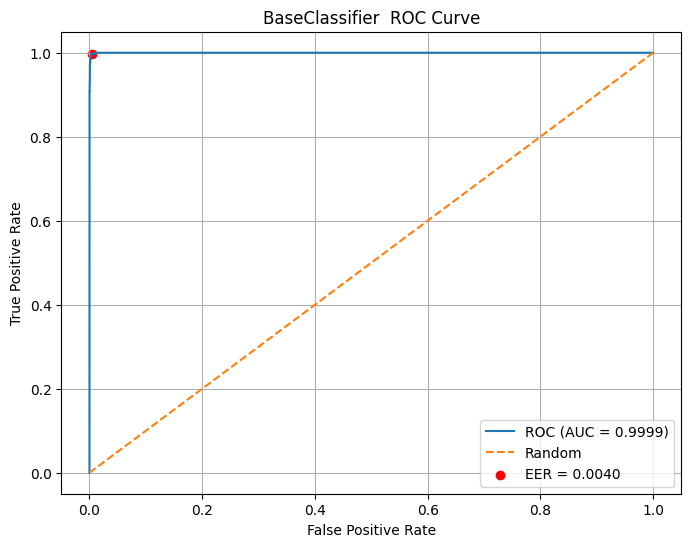

In [22]:
Test(model_base, Test_loader, "BaseClassifier ")

In [15]:
model_res = ResNetClassifier(num_layers, hidden_dim, num_classes).to(device)
optimizer_res = optim.Adam(model_res.parameters(), lr=1e-3)

In [16]:
print("\nTraining ResNetClassifier...")
eer_res = Train(model_res, optimizer_res, criterion, Train_loader, Val_loader)



Training ResNetClassifier...
Epoch 1/50, Loss: 0.0754, Val EER: 0.0122
Epoch 2/50, Loss: 0.0319, Val EER: 0.0081
Epoch 3/50, Loss: 0.0227, Val EER: 0.0366
Epoch 4/50, Loss: 0.0202, Val EER: 0.0064
Epoch 5/50, Loss: 0.0172, Val EER: 0.0240
Epoch 6/50, Loss: 0.0156, Val EER: 0.0259
Epoch 7/50, Loss: 0.0159, Val EER: 0.0129
Epoch 8/50, Loss: 0.0161, Val EER: 0.0062
Epoch 9/50, Loss: 0.0142, Val EER: 0.0691
Epoch 10/50, Loss: 0.0132, Val EER: 0.0053
Epoch 11/50, Loss: 0.0125, Val EER: 0.0058
Epoch 12/50, Loss: 0.0119, Val EER: 0.0070
Epoch 13/50, Loss: 0.0162, Val EER: 0.0051
Epoch 14/50, Loss: 0.0132, Val EER: 0.0154
Epoch 15/50, Loss: 0.0157, Val EER: 0.0073
Epoch 16/50, Loss: 0.0136, Val EER: 0.0059
Epoch 17/50, Loss: 0.0111, Val EER: 0.0070
Epoch 18/50, Loss: 0.0108, Val EER: 0.0058
Epoch 19/50, Loss: 0.0106, Val EER: 0.0084
Epoch 20/50, Loss: 0.0113, Val EER: 0.0059
Epoch 21/50, Loss: 0.0096, Val EER: 0.0103
Epoch 22/50, Loss: 0.0086, Val EER: 0.0114
Epoch 23/50, Loss: 0.0096, Val EE

=== Evaluation Metrics: ResNetClassifier ===
Accuracy : 0.9958
Precision: 0.9833
Recall   : 0.9752
F1 Score : 0.9793
FPR      : 0.0019
FNR      : 0.0248
EER      : 0.0037
AUC      : 0.9998


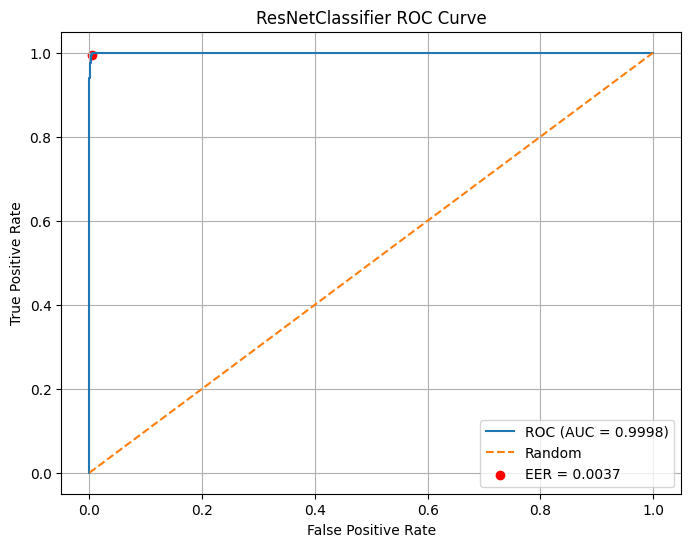

In [17]:
Test(model_res, Test_loader, "ResNetClassifier")

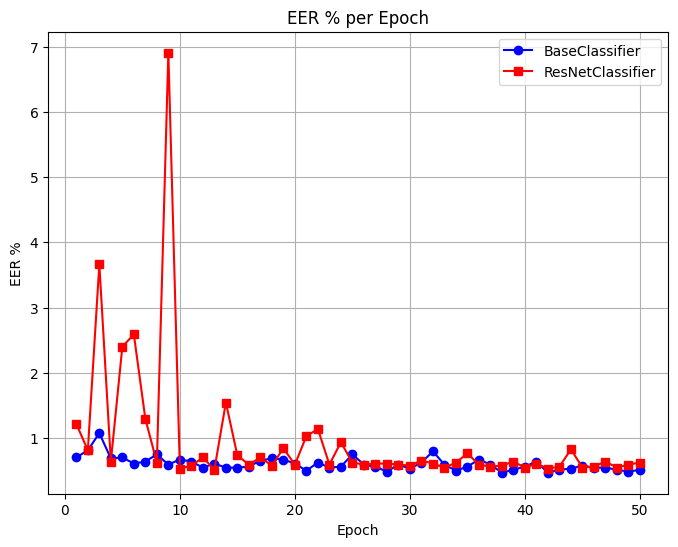

In [24]:
num_epochs = 50
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs+1), [100*eer for eer in eer_base], marker='o', label="BaseClassifier", color='b')
plt.plot(range(1, num_epochs+1), [100*eer for eer in eer_res], marker='s', label="ResNetClassifier", color='r')
plt.xlabel("Epoch")
plt.ylabel("EER %")
plt.title("EER % per Epoch")    
plt.legend()
plt.grid(True)
plt.show()

In [25]:
pkl_path = "FoR_Train_AL_Dataset.pkl"
FoR_train_dataset = LayerFeatureDataset(pkl_path)

pkl_path = "FoR_Validation_AL_Dataset.pkl"
FoR_val_dataset = LayerFeatureDataset(pkl_path)

pkl_path = "FoR_Test_AL_Dataset.pkl"
FoR_test_dataset = LayerFeatureDataset(pkl_path)

Train_loader = DataLoader(FoR_train_dataset, batch_size=64, shuffle=True)
Val_loader = DataLoader(FoR_val_dataset, batch_size=64, shuffle=False)
Test_loader = DataLoader(FoR_test_dataset, batch_size=64, shuffle=False)
print(f"Training samples: {len(FoR_train_dataset)}, Validation samples: {len(FoR_val_dataset)}, Testing samples: {len(FoR_test_dataset)}")

Training samples: 53866, Validation samples: 10798, Testing samples: 4634


Epoch 1/50, Loss: 0.0437, Val EER: 0.0037
Epoch 2/50, Loss: 0.0053, Val EER: 0.0017
Epoch 3/50, Loss: 0.0038, Val EER: 0.0017
Epoch 4/50, Loss: 0.0027, Val EER: 0.0015
Epoch 5/50, Loss: 0.0025, Val EER: 0.0004
Epoch 6/50, Loss: 0.0021, Val EER: 0.0013
Epoch 7/50, Loss: 0.0015, Val EER: 0.0009
Epoch 8/50, Loss: 0.0021, Val EER: 0.0006
Epoch 9/50, Loss: 0.0015, Val EER: 0.0015
Epoch 10/50, Loss: 0.0006, Val EER: 0.0004
Epoch 11/50, Loss: 0.0010, Val EER: 0.0009
Epoch 12/50, Loss: 0.0009, Val EER: 0.0006
Epoch 13/50, Loss: 0.0004, Val EER: 0.0011
Epoch 14/50, Loss: 0.0015, Val EER: 0.0007
Epoch 15/50, Loss: 0.0007, Val EER: 0.0007
Epoch 16/50, Loss: 0.0006, Val EER: 0.0007
Epoch 17/50, Loss: 0.0013, Val EER: 0.0007
Epoch 18/50, Loss: 0.0001, Val EER: 0.0009
Epoch 19/50, Loss: 0.0008, Val EER: 0.0006
Epoch 20/50, Loss: 0.0010, Val EER: 0.0007
Epoch 21/50, Loss: 0.0005, Val EER: 0.0007
Epoch 22/50, Loss: 0.0002, Val EER: 0.0013
Epoch 23/50, Loss: 0.0000, Val EER: 0.0000
Epoch 24/50, Loss: 0

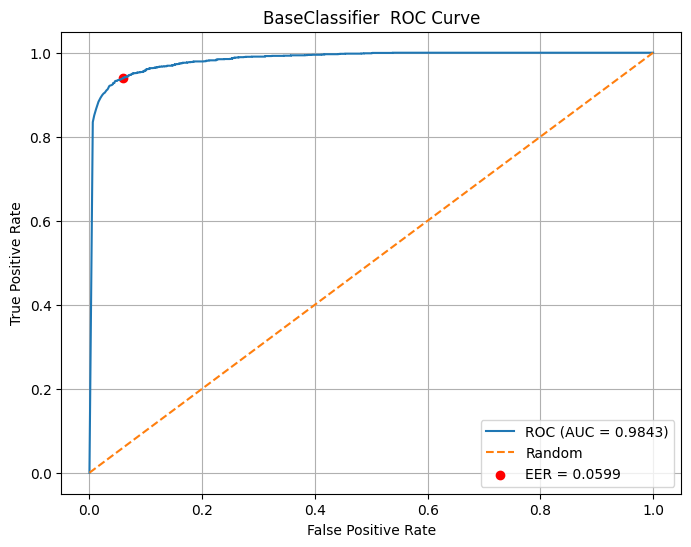

In [26]:
eer_base = Train(model_base, optimizer_base, criterion, Train_loader, Val_loader)
Test(model_base, Test_loader, "BaseClassifier ")

Epoch 1/50, Loss: 0.0544, Val EER: 0.0011
Epoch 2/50, Loss: 0.0046, Val EER: 0.0013
Epoch 3/50, Loss: 0.0029, Val EER: 0.0017
Epoch 4/50, Loss: 0.0019, Val EER: 0.0007
Epoch 5/50, Loss: 0.0018, Val EER: 0.0006
Epoch 6/50, Loss: 0.0012, Val EER: 0.0015
Epoch 7/50, Loss: 0.0026, Val EER: 0.0006
Epoch 8/50, Loss: 0.0009, Val EER: 0.0013
Epoch 9/50, Loss: 0.0010, Val EER: 0.0006
Epoch 10/50, Loss: 0.0006, Val EER: 0.0002
Epoch 11/50, Loss: 0.0013, Val EER: 0.0002
Epoch 12/50, Loss: 0.0009, Val EER: 0.0000
Epoch 13/50, Loss: 0.0005, Val EER: 0.0002
Epoch 14/50, Loss: 0.0004, Val EER: 0.0007
Epoch 15/50, Loss: 0.0012, Val EER: 0.0013
Epoch 16/50, Loss: 0.0013, Val EER: 0.0002
Epoch 17/50, Loss: 0.0001, Val EER: 0.0000
Epoch 18/50, Loss: 0.0009, Val EER: 0.0002
Epoch 19/50, Loss: 0.0011, Val EER: 0.0000
Epoch 20/50, Loss: 0.0003, Val EER: 0.0007
Epoch 21/50, Loss: 0.0005, Val EER: 0.0013
Epoch 22/50, Loss: 0.0008, Val EER: 0.0006
Epoch 23/50, Loss: 0.0001, Val EER: 0.0004
Epoch 24/50, Loss: 0

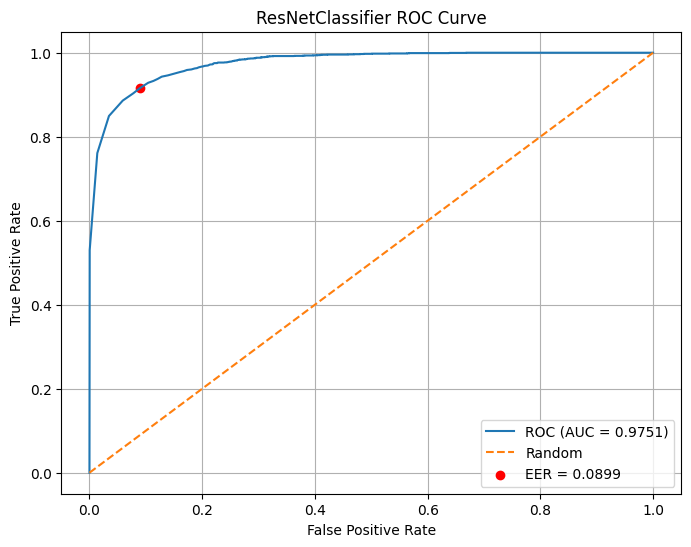

In [27]:
eer_res = Train(model_res, optimizer_res, criterion, Train_loader, Val_loader)
Test(model_res, Test_loader, "ResNetClassifier")

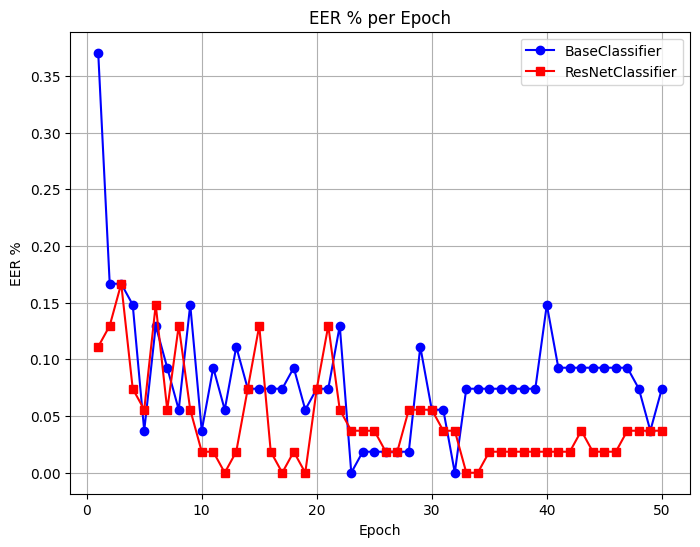

In [28]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs+1), [100*eer for eer in eer_base], marker='o', label="BaseClassifier", color='b')
plt.plot(range(1, num_epochs+1), [100*eer for eer in eer_res], marker='s', label="ResNetClassifier", color='r')
plt.xlabel("Epoch")
plt.ylabel("EER %")
plt.title("EER % per Epoch")
plt.legend()
plt.grid(True)
plt.show()